# Uploading libraries

In [232]:
# Fundamental libraries

import os
import random
import time
import copy

# Working libraries
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
import torch.utils.data as data
import torchvision
from torchvision import transforms
import torchvision.transforms.functional as TF
from torchvision.io import read_image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, datasets, models
import torch.optim as optim
from torch.optim import lr_scheduler

# Evaluation
from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay

# FILE PATHS on local environment : mariias_env

#### Each folder path represent class (label) :

**Folder name - calss name : description**

0 - 0 class : dead and empty organoids

1 - 1 class : sparse dots (seeding)

2 - 2 class : small distance between organoids, circle shape, size near 50 nm (split)

3 - 3 class : size < 300 nm, organoids without crypt

4 -  4 class : size > 400 nm, organoids with crypt

In [242]:
# paths for data upload
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_0 = FILE_PATH + '/0' 
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/1'
TRAIN_FEATURES_PATH_2 = FILE_PATH + '/2'
TRAIN_FEATURES_PATH_3 = FILE_PATH + '/3'
TRAIN_FEATURES_PATH_4 = FILE_PATH + '/4'

# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_0,TRAIN_FEATURES_PATH_1,TRAIN_FEATURES_PATH_2,TRAIN_FEATURES_PATH_3,TRAIN_FEATURES_PATH_4]

In [48]:
PATHES_LIST

['mariias_env/0',
 'mariias_env/1',
 'mariias_env/2',
 'mariias_env/3',
 'mariias_env/4']

# Data set : train & test

The data was divided into training and testing sets for each class, with a split of 80% for training and 20% for testing, maintaining the same ratio for each class. However, the dataset exhibits an imbalance issue, with one class having a significantly larger number of samples compared to the other class.

In [49]:
print("Class 0 : train : ",round(len(os.listdir(PATHES_LIST[0]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[0]))*0.2))

Class 0 : train :  86  test :  22


In [50]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[1]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[1]))*0.2))

Class 1 : train :  28  test :  7


In [51]:
print("Class 2 : train : ",round(len(os.listdir(PATHES_LIST[2]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[2]))*0.2))

Class 2 : train :  46  test :  12


In [52]:
print("Class 3 : train : ",round(len(os.listdir(PATHES_LIST[3]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[3]))*0.2))

Class 3 : train :  68  test :  17


In [53]:
print("Class 4 : train : ",round(len(os.listdir(PATHES_LIST[4]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[4]))*0.2))

Class 4 : train :  37  test :  9


### Customise test data set

The class `CustomImageDataset_test` is a custom dataset class used for testing or evaluating a machine learning model on a specific set of images. Here's a brief explanation of why it's needed:

1. **Path List**: The `path_list` parameter contains the list of paths to directories where the images are located. Each directory represents a different class or category.

2. **Transform**: The `transform` parameter represents the image transformations that need to be applied to each image, such as resizing, normalization, or augmentation.

3. **Ratio**: The `ratio` parameter determines the proportion of images that will be used for testing. It allows you to specify the desired split between the training and testing datasets.

4. **Initialization**: During initialization, the class calculates the size of each class based on the number of image files in the corresponding directory. It then determines the number of images to be included in the test set based on the specified ratio.

5. **Data Organization**: The class organizes the image paths and their corresponding labels, keeping only the images that will be used for testing. This ensures that the test dataset contains the desired proportion of samples from each class.

6. **Length and Indexing**: The `__len__` method returns the total number of images in the test set, while the `__getitem__` method allows indexing to retrieve a specific image and its label.

7. **Image Processing**: Within `__getitem__`, the class reads the image from the file path, converts it to a floating-point tensor, and applies the specified transformations. The image tensor and its corresponding label are then returned as a tuple.

By implementing this custom dataset class, you can easily load and process the test data in a standardized manner, making it convenient to evaluate the model's performance on a specific test set.

In [244]:
class CustomImageDataset_test(Dataset):
    def __init__(self, path_list, transform,ratio):
        self.path_list = path_list
        self.len = 0
        self.img_labels = []
        self.img_sort = []
        self.transform = transform
        for i, img_dir in enumerate(path_list):
            class_size = len([f for f in sorted(os.listdir(img_dir)) if f.endswith(".png")])
            class_size_test = round(class_size*(1-ratio)) # using ration to separate tran and test data set
            self.len += class_size_test
            self.img_labels.extend([i] * class_size_test)
            self.img_sort.extend(sorted([os.path.join(img_dir, f) for f in sorted(os.listdir(img_dir)) if f.endswith(".png")][-self.len:]))   

    def __len__(self):
        return self.len

    def __getitem__(self, idx):
        img_path = self.img_sort[idx]
        image = read_image(img_path).float() / 255
        label = self.img_labels[idx]
        image = self.transform(image)
        return image, label

### Customise train data set

The class `CustomImageDataset_train` is another custom dataset class specifically designed for training a machine learning model using augmented images. Here's a brief explanation of why it's needed, along with the rationale behind using data augmentation techniques:

1. **Path List**: Similar to the previous class, the `path_list` parameter contains the list of paths to directories where the training images are located.

2. **Transform**: The `transform` parameter represents the image transformations that need to be applied to each training image, such as resizing, normalization, or augmentation.

3. **Ratio**: The `ratio` parameter determines the proportion of images that will be used for training. It allows you to specify the desired split between the training and testing datasets.

4. **Initialization**: During initialization, the class calculates the size of each class based on the number of image files in the corresponding directory. It then determines the number of images to be included in the training set based on the specified ratio.

5. **Data Organization**: The class organizes the image paths and their corresponding labels, keeping only the images that will be used for training.

6. **Length and Indexing**: The `__len__` method returns the total number of images in the training set, while the `__getitem__` method allows indexing to retrieve a specific image and its label.

7. **Image Processing**: Within `__getitem__`, the class reads the image from the file path, converts it to a floating-point tensor, and applies the specified transformations. Additionally, the class applies data augmentation techniques to the training images to enhance the diversity and generalizability of the dataset.

8. **Augmentation Techniques**: The `augmentation` method implements several augmentation techniques commonly used for image data. These techniques include random cropping, random horizontal and vertical flipping, and rotation by a random angle between 0 and 45 degrees. By applying these techniques randomly to each training image, the dataset becomes more robust and less sensitive to variations in the input data.

The purpose of using data augmentation is to artificially increase the size and variability of the training dataset. This helps prevent overfitting and improves the model's ability to generalize to new, unseen data. By introducing random transformations during training, the model becomes more resilient to variations in the test data and can better handle real-world scenarios.

Overall, the `CustomImageDataset_train` class provides a convenient way to load, preprocess, and augment the training data, enabling effective training of machine learning models on a diverse and expanded dataset.

In [245]:
class CustomImageDataset_train(Dataset):
    def __init__(self, path_list, transform,ratio):
        self.path_list = path_list
        self.len = 0
        self.img_labels = []
        self.img_sort = []
        self.transform = transform
        for i, img_dir in enumerate(path_list):
            class_size = len([f for f in sorted(os.listdir(img_dir)) if f.endswith(".png")])
            class_size_train = class_size - round(class_size*(1-ratio))
            self.len += class_size_train
            self.img_labels.extend([i] * class_size_train)

            self.img_sort.extend(sorted([os.path.join(img_dir, f) for f in sorted(os.listdir(img_dir)) if f.endswith(".png")][:self.len]))
        

    def __len__(self):
        return self.len

    def __getitem__(self, idx):
        img_path = self.img_sort[idx]
        image = read_image(img_path).float() / 255.
        label = self.img_labels[idx]
        image = self.transform(image)
        image = self.augmentation(image)
        return image, label
        
    def augmentation(self, image):
        
        # Random crop
        i, j, h, w = transforms.RandomCrop.get_params(image, output_size=(256, 256))
        image = TF.crop(image, i, j, h, w)
        #label = TF.crop(label, i, j, h, w)
        
        # Random horizontal flipping
        if random.random() > 0.5:
            image = TF.hflip(image)
            #label = TF.hflip(label)

        # Random vertical flipping
        if random.random() > 0.5:
            image = TF.vflip(image)
            #label = TF.vflip(label)
       
        # Rotation 45*
        degree = transforms.RandomRotation.get_params((0,45))
        image = TF.rotate(image, degree)
        #label = TF.rotate(label, degree)
        
        return image

### Separate data to train and test data with ratio 0.8 in test data

To utilize the CustomImageDataset_test and CustomImageDataset_train, it is necessary to specify the desired transformations for each case, such as Normalize and CenterCrop.

The following code demonstrates how to define the transformations:

For test data transformation using CenterCrop:

In [240]:
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    #transforms.Normalize(mean, std, inplace=False) # will define later
    ])

For train data transformation:

In [241]:
TRANSFORM_TRAIN_IMG = transforms.Compose([

    #transforms.Normalize(mean, std, inplace=False) # will define later
    ])

In [246]:
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)


67

In [24]:
# Checking first image in test data
image  = next(iter(data_set_test))[0]
image.shape

torch.Size([1, 256, 256])

In [66]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

265

In [27]:
# checking all labels in test data
classes = []
for i in range(len(data_set_test)):
    classes.append(data_set_test[i][1])
classes

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4]

### Visualization of test data

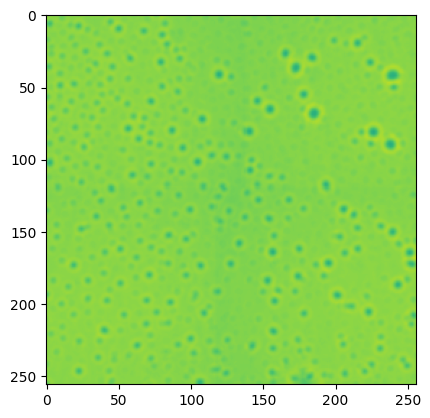

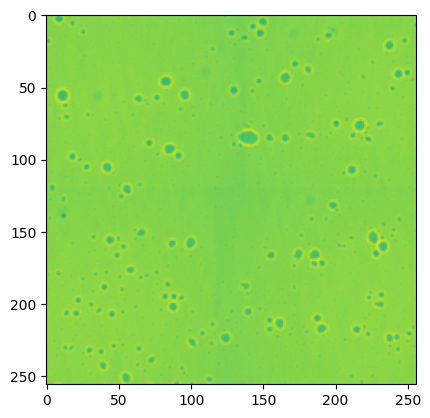

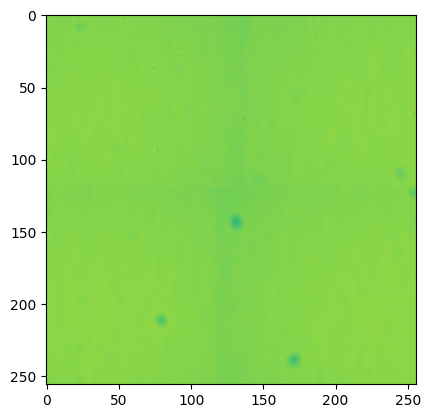

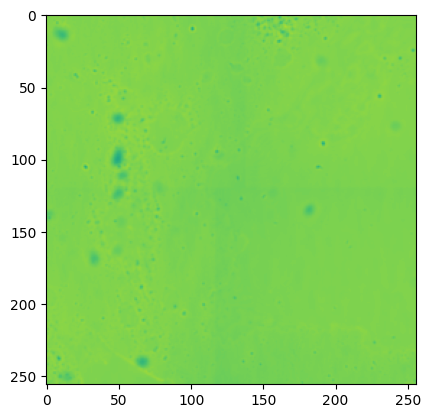

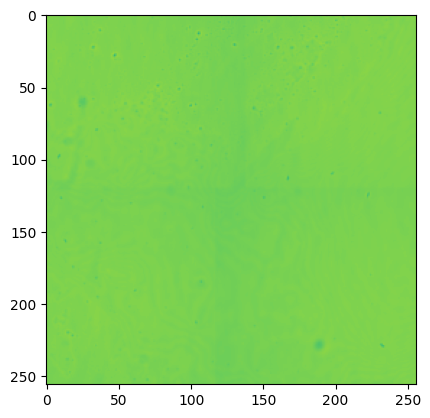

...

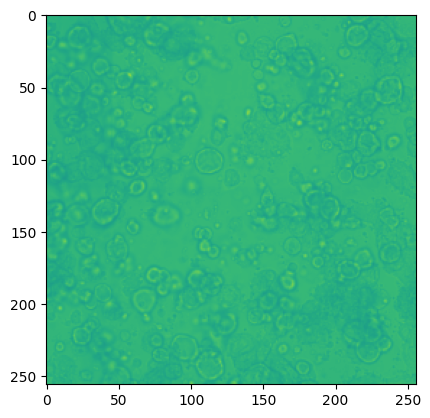

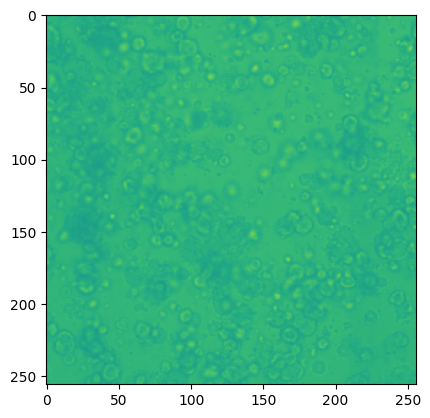

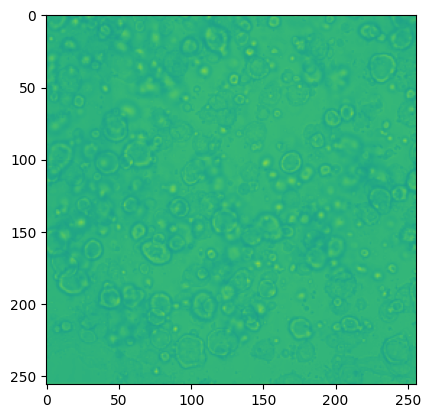

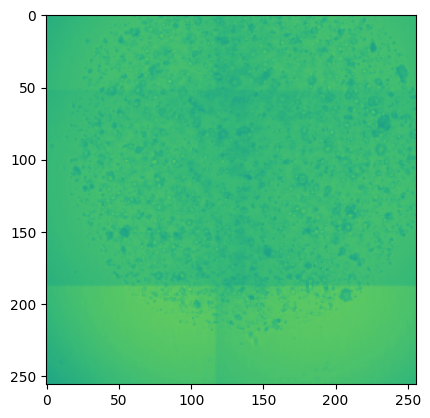

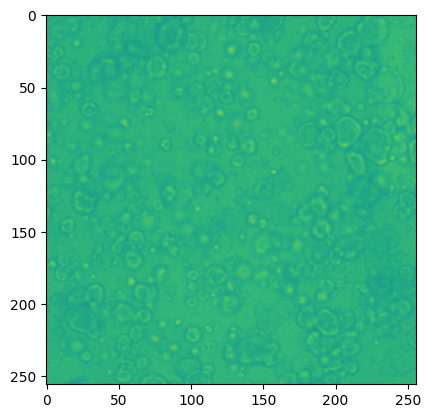

In [24]:
# before normalization
for i in iter(data_set_test):
    plt.imshow(i[0][0],vmin=-1,vmax=1)
    plt.show()

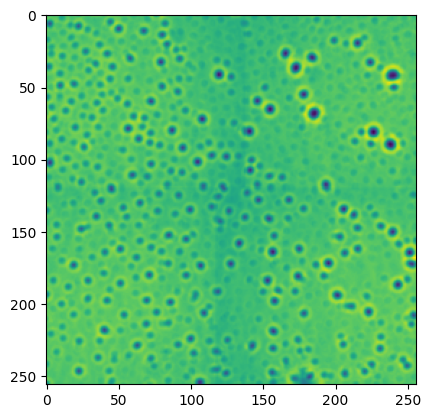

In [25]:
plt.imshow(image[0])

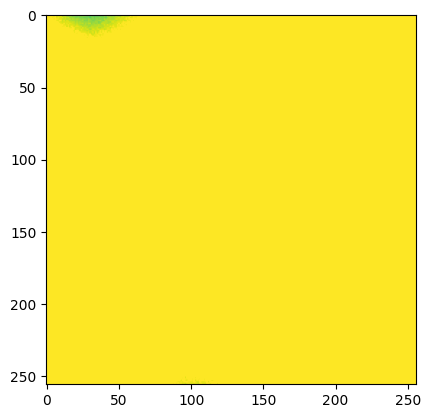

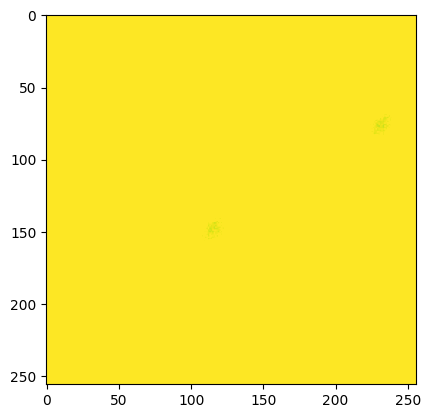

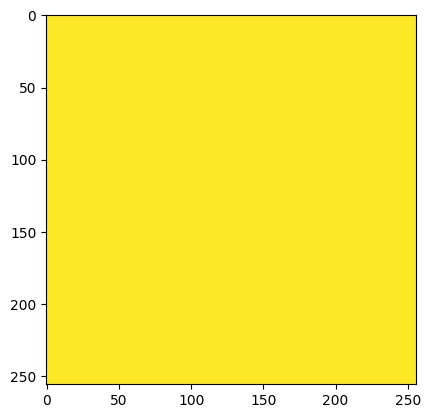

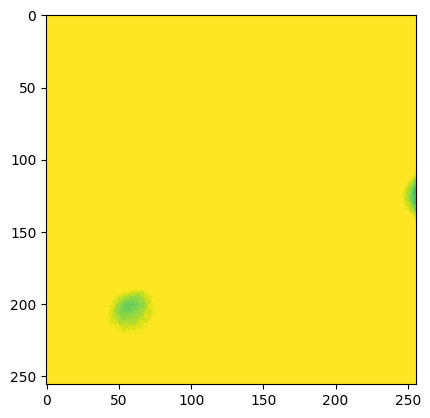

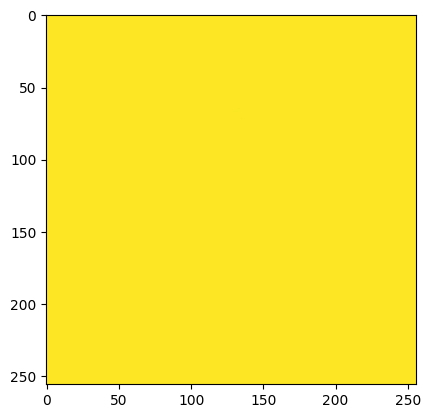

...

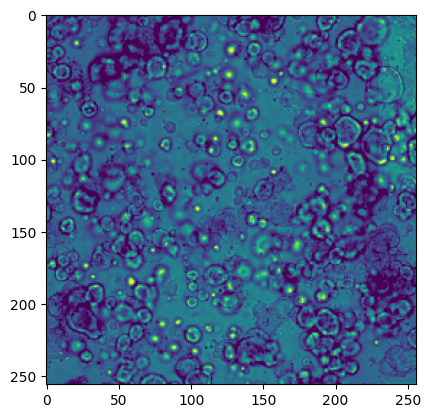

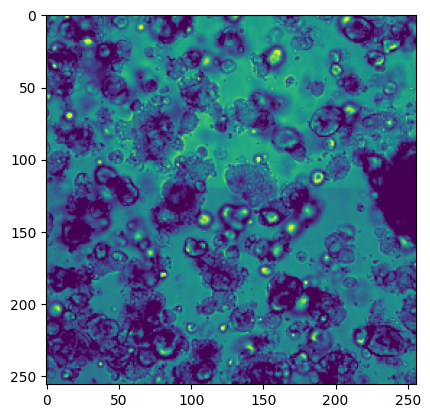

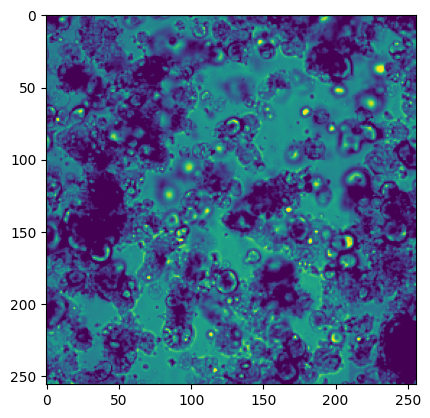

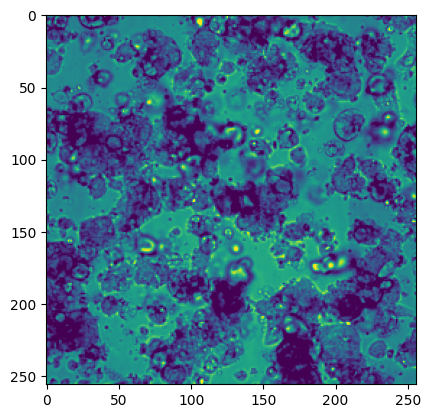

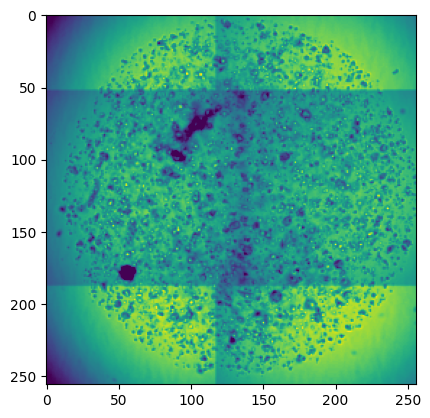

In [38]:
#after normalization
for i in iter(data_set_test):
    plt.imshow(i[0][0],vmin=-1,vmax=1)
    plt.show()

# Normalization

Normalization is necessary in machine learning to standardize the input data and bring it to a common scale. Here's a brief explanation of why normalization is needed:



1. **Centering the Data**: By subtracting the mean from each feature, normalization centers the data around zero. This helps in eliminating any biases or offsets in the data, ensuring that the mean of each feature becomes zero.

2. **Equalizing the Scale**: Dividing the centered data by the standard deviation ensures that all features have a comparable scale. It brings the features to a similar range, preventing one feature from dominating others solely due to a larger magnitude.

3. **Stabilizing the Learning Process**: Normalizing the data helps stabilize the learning process during model training. Large input values can lead to large gradients, making the learning process unstable and slower. Normalization helps mitigate this issue and improves the convergence speed and stability of the optimization algorithm.

4. **Improving Numerical Stability**: Normalization helps avoid numerical instabilities that can arise when dealing with large or small feature values. It prevents potential issues like overflow or underflow during computations by scaling the data to a more manageable range.

5. **Facilitating Model Interpretation**: Normalization simplifies the interpretation of the model's coefficients or weights. Since the features are on a similar scale, the magnitude of the coefficients can be directly compared to assess their importance and contribution to the model's predictions.

6. **Assumption of Some Algorithms**: Certain machine learning algorithms, such as linear regression, logistic regression, and support vector machines, assume that the input data is normalized. Violating this assumption may lead to biased or incorrect model estimates.

By normalizing the data by subtracting the mean and dividing by the standard deviation, you ensure that the data is centered, features are scaled consistently, and the learning process is stable and efficient. This normalization technique is widely used to preprocess the input data and improve the performance and interpretability of machine learning models.

In [28]:
# mean of test data
torch.mean(data_set_test[0][0])

tensor(0.5862)

In [29]:
# max of test data
torch.max(data_set_train[0][0])

tensor(0.6667)

In [58]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

In [21]:
mean = np.mean(test_Set)
mean

0.3397367625303988

In [59]:
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number

In [60]:
std = torch.std(torch.stack(test_image))
std

tensor(0.6416)

# TRANSFORMS & LOADER train & test data sets

There is two transform for test and train data. Two important transformations are used: `Normalize` and `CenterCrop`. Here's a brief explanation of each transformation and its purpose:

1. **Normalize**: The `Normalize` transformation is applied to both the training and test images. It helps normalize the pixel values of the images to a standard scale, typically zero mean and unit variance. The `mean` and `std` parameters represent the mean and standard deviation values used for normalization.

   - By normalizing the pixel values, the model becomes less sensitive to variations in brightness and contrast across different images.
   - Normalization can improve the model's stability during training and its ability to generalize to unseen data.

2. **CenterCrop**: The `CenterCrop` transformation is applied only to the training images. It crops the images from the center to a specified size, in this case, (256, 256) pixels.

   - Center cropping helps extract the most relevant and informative parts of the image, discarding any unnecessary surrounding areas.
   - This transformation is often used when the central region of an image contains the most important features or when the input size of the model is fixed and requires consistent input dimensions.


#### TRANSFORM test data : CenterCrop and Normalization 

In [61]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])

#### TRANSFORM train data : Normalization 

In [62]:
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

#### Using TRANSFORMs with defined transformation :Normalization 

In [248]:
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)

#### LOADER 

Data loaders (`train_loader` and `test_loader`) using `torch.utils.data.DataLoader` to facilitate efficient batching and shuffling of the data during training and testing.

- The `train_loader` is configured with a batch size of 4, which means that during training, the model will be presented with 4 images at a time for each training step.
- The `shuffle=True` parameter ensures that the samples are randomly shuffled before each epoch of training, introducing randomness and reducing any bias caused by the original order of the samples.
- The `test_loader` is configured with the `shuffle=True` parameter as well, meaning that the order of the test samples will be randomized during evaluation, which helps assess the model's generalization performance across different sample orders.


In [28]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

# FUNCTIONS : accuracy , train_model

The `accuracy` function calculates the accuracy of model predictions given the predicted logits (`x`) and ground truth labels (`y`). Here's a brief description of how the function works:

- **Inputs**:
  - `x`: Predictions (logits) generated by a model. It is a torch tensor of shape (B, C), where B is the batch size and C is the number of classes. Each row represents the predicted logits for a single sample.
  - `y`: Ground truth labels. It is a torch tensor of shape (B,) containing the true labels for each sample in the batch. The labels are integers ranging from 0 to C-1, where C is the number of classes.

- **Output**:
  - Accuracy: The accuracy value represents the proportion of correct predictions over the total number of samples in the batch. It is a floating-point number in the range [0, 1].

- **Function Flow**:
  1. The function first detaches `x` and `y` from the computation graph and moves them to the CPU, converting them into numpy arrays. This step is performed to enable further processing using NumPy functions.
  2. The function then calculates the accuracy by comparing the predicted class labels (obtained by taking the argmax along the axis 1 of `x`) with the ground truth labels (`y`).
  3. The comparison `np.argmax(x, axis=1) == y` creates a boolean array of shape (B,), where each element indicates whether the predicted label matches the ground truth label.
  4. Finally, the accuracy is calculated by taking the mean of the boolean array, where `True` values are treated as 1 and `False` values as 0.

The `accuracy` function provides a convenient way to evaluate the accuracy of model predictions against ground truth labels. It is a common metric used to assess the performance of classification models.

In [29]:
def accuracy(x, y):
    """ Accuracy.

    Args:
        x (torch.Tensor of float32): Predictions (logits), shape (B, C), B is
            batch size, C is num classes.
        y (torch.Tensor of int64): GT labels, shape (B, ),
            B = {b: b \in {0 .. C-1}}.

    Returns:
        Accuracy, in [0, 1].
    """
    x = x.detach().cpu().numpy()
    y = y.detach().cpu().numpy()
    return np.mean(np.argmax(x, axis=1) == y)

The `train_model` function trains a given model using the specified criterion, optimizer, training data loader, and test data loader for a specified number of epochs. Here's a breakdown of how the function works:

- **Inputs**:
  - `model`: The model to be trained.
  - `criterion`: The loss function used to compute the loss between the predicted logits and the ground truth labels.
  - `optimizer`: The optimizer responsible for updating the model's weights based on the computed gradients.
  - `dataloader_train`: The data loader containing the training data, which provides batches of input samples and corresponding labels.
  - `dataloader_test`: The data loader containing the test data used for evaluating the model's performance during training.
  - `epochs`: The number of times to iterate over the training data.

- **Function Flow**:
  1. The function iterates over the specified number of epochs using a `for` loop.
  2. Inside each epoch, the model is set to training mode using `model.train()` to enable gradient computation and weight updates.
  3. Two empty lists, `losses_sum` and `accuracy_sum`, are initialized to store the losses and accuracies for each batch during training.
  4. The training data loader (`dataloader_train`) is iterated over using a `for` loop, which provides batches of input samples and labels.
  5. For each batch:
     - The input samples and labels (`x` and `y`) are loaded.
     - The forward pass is performed by passing the input samples through the model to obtain the predicted logits.
     - The accuracy of the predictions is calculated using the `accuracy` function and appended to `accuracy_sum`.
     - The loss is computed by applying the criterion (loss function) to the logits and ground truth labels.
     - The loss is added to `losses_sum` after detaching it from the computation graph.
     - The gradients are computed using backpropagation by calling `loss.backward()`.
     - The optimizer updates the model's weights based on the computed gradients by calling `optimizer.step()`.
     - The accumulated gradients are zeroed out to prepare for the next iteration by calling `optimizer.zero_grad()`.
  6. After completing the training loop, the model is set to evaluation mode.
  7. Two empty lists, `losses_sum_test` and `accuracy_sum_test`, are initialized to store the losses and accuracies for each batch during testing.
  8. The test data loader (`dataloader_test`) is iterated over to evaluate the model's performance on the test set.
  9. For each test batch, the forward pass is performed, and the accuracy and loss are calculated similarly to the training phase, and the values are appended to `accuracy_sum_test` and `losses_sum_test`.
  10. Finally, the function prints the average train loss, train accuracy, test loss, and test accuracy for the current epoch.

The `train_model` function encapsulates the training loop for a specified number of epochs, updating the model's weights based on the computed gradients and evaluating its performance on the test set. It provides an overview of the model's progress during training, including train and test losses and accuracies for each epoch.

In [30]:
def train_model(model, criterion, optimizer, dataloader_train, dataloader_test, epochs):
    for ep in range(epochs):
        # Training.
        
        model.train()
        losses_sum = []
        accuracy_sum = []
        for it, batch in enumerate(dataloader_train):
            # 1 Load a batch.
            x, y = batch

            # 2 Run forward pass.
            logits = model(x)  
            accuracy_sum.append(accuracy(logits, y))
            # 3 Compute loss (using 'criterion').
            loss = criterion(logits, y)  
            losses_sum.append(loss.detach())
            # 4 Run backward pass.
            loss.backward() 
            
            # 5 Update the weights using optimizer.
            optimizer.step()  
            
            # 6 Zero-out the accumulated gradients.
            optimizer.zero_grad() 

                   
       
        accuracy_sum_test = []
        losses_sum_test = []
        for batch in dataloader_test:
            x, y = batch
            logits = model(x) 
            accuracy_sum_test.append(accuracy(logits, y))
            loss = criterion(logits, y)  
            losses_sum_test.append(loss.detach())
            
        print("Number of Epoch : {}, Train Loss : {:.2f}, Train Accuracy : {:.2f}, Test Loss : {:.2f}, Test Accuracy : {:.2f}".format(ep,np.mean(np.array(losses_sum)),np.mean(np.array(accuracy_sum)),np.mean(np.array(losses_sum_test)),np.mean(np.array(accuracy_sum_test))))

# ARCHITECTURES OF MODELS

The deep learning model utilized in this project is based on the LeNet architecture, which is a convolutional neural network designed for image classification tasks. The model incorporates various approaches to mitigate overfitting, such as Dropout and Batch Normalization, which help improve generalization and prevent the model from memorizing the training data

### CNN_LeNet : 
#### DISCRIPTOR : 

2 CONV2 with STRIDE=2 AND PADDING=1 (it adds a border of 1 pixel of zeros around the input tensor before performing the convolution) \
1st CONV2 :  ouput 6 channels \
2st CONV2 :  ouput 16 channels 

In [45]:
class CNN_LeNet(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 5) # 5 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)
    
# Instantiate the model.
model_lenet = CNN_LeNet()

In [48]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)
The model has 503,169 parameters.


### CNN_ : 
#### DISCRIPTOR : 

2 CONV2 with STRIDE=2 AND PADDING=1 \
1st CONV2 :  ouput 16 channels \
2st CONV2 :  ouput 32 channels 

In [46]:
class CNN_(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,16, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(16, 32, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(32 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 5) # 5 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

### CNN_batch : 
#### DISCRIPTOR : CNN_ + batch normalization

2 CONV2 with STRIDE=2 AND PADDING=1 \
1st CONV2 :  ouput 16 channels \
2st CONV2 :  ouput 32 channels 

In [47]:
class CNN_batch(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_batch, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,16, 3, padding=1,stride=2)
        self.batchnorm1 = torch.nn.BatchNorm2d(16, eps=1e-05, momentum=0.1)
        self.conv2d2 = torch.nn.Conv2d(16, 32, 3, padding=1,stride=2)
        self.batchnorm2 = torch.nn.BatchNorm2d(32, eps=1e-05, momentum=0.1)
        self.fc1 = nn.Linear(32 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 5) # 5 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.batchnorm1(self.conv2d1(x))), 2)
        x = F.max_pool2d(F.relu(self.batchnorm2(self.conv2d2(x))), 2)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

### CNN_LeNet_drop_out : 
#### DISCRIPTOR : CNN_LeNet + drop_out

2 CONV2 with STRIDE=2 AND PADDING=1 \
1st CONV2 :  ouput 6 channels \
2st CONV2 :  ouput 16 channels 

In [41]:
class CNN_LeNet_drop_out(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet_drop_out, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 5) # 5 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [34]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet_drop_out()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)
The model has 503,169 parameters.


### ConvNet2 : 
#### DISCRIPTOR : CNN_LeNet + drop_out + batch normalization

2 CONV2 with STRIDE=2 AND PADDING=1 \
1st CONV2 :  ouput 6 channels \
2st CONV2 :  ouput 16 channels 

In [176]:
# architecture of CNN
class ConvNet2(nn.Module):
    def __init__(self):
        super().__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.batchnorm1 = torch.nn.BatchNorm2d(6, eps=1e-05, momentum=0.1)
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.batchnorm2 = torch.nn.BatchNorm2d(16, eps=1e-05, momentum=0.1)
        self.fc1 = nn.Linear(16 * 16 * 16 , 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 5) # 10 classes 
    
    def forward(self, x):
        #torch.nn.functional.max_pool2d(input, kernel_size)
        # used batch normalization and dropout to protect against overfitting
        x = F.max_pool2d(F.relu(self.batchnorm1(self.conv2d1(x))), 2) # used batch normlalization after convolution but before non-linear function
        x = F.max_pool2d(F.relu(self.batchnorm2(self.conv2d2(x))), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    # function for future prediction
    def predict(self, x): 
        logits = self.forward(x)
        return F.softmax(logits)

# Training models and evaluation the best one

Training part for each architecture with different hyperparameters

**RESULT :**

**Best model : CNN_LeNEt_drop_out()**

**Hyperparameters :**

**1. batch size : 4**

**2. Optimizer : AdamW**

**3. Learning rate : 1e-4 epochs = 1000**

**4. Accuracy : 45 % Max Accuracy during train : 52%**

##### Model : CNN_LeNet_drop_out() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 1e-3

In [36]:
# Train the model used as BST MODEL

model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 10
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.45, Train Accuracy : 0.37, Test Loss : 1.37, Test Accuracy : 0.40
Number of Epoch : 1, Train Loss : 1.35, Train Accuracy : 0.45, Test Loss : 1.75, Test Accuracy : 0.43
Number of Epoch : 2, Train Loss : 1.31, Train Accuracy : 0.48, Test Loss : 1.69, Test Accuracy : 0.45
Number of Epoch : 3, Train Loss : 1.25, Train Accuracy : 0.48, Test Loss : 1.28, Test Accuracy : 0.54
Number of Epoch : 4, Train Loss : 1.17, Train Accuracy : 0.55, Test Loss : 1.21, Test Accuracy : 0.48
Number of Epoch : 5, Train Loss : 1.11, Train Accuracy : 0.53, Test Loss : 1.70, Test Accuracy : 0.43
Number of Epoch : 6, Train Loss : 1.18, Train Accuracy : 0.52, Test Loss : 1.63, Test Accuracy : 0.43
Number of Epoch : 7, Train Loss : 1.09, Train Accuracy : 0.56, Test Loss : 1.52, Test Accuracy : 0.43


KeyboardInterrupt: 

##### Model : CNN_LeNet_drop_out() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 1e-4 

In [459]:
# Train the model used as BST MODEL

model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.59, Train Accuracy : 0.33, Test Loss : 1.57, Test Accuracy : 0.33
Number of Epoch : 1, Train Loss : 1.56, Train Accuracy : 0.32, Test Loss : 1.54, Test Accuracy : 0.33
Number of Epoch : 2, Train Loss : 1.54, Train Accuracy : 0.33, Test Loss : 1.52, Test Accuracy : 0.33
Number of Epoch : 3, Train Loss : 1.54, Train Accuracy : 0.32, Test Loss : 1.47, Test Accuracy : 0.33
Number of Epoch : 4, Train Loss : 1.52, Train Accuracy : 0.32, Test Loss : 1.40, Test Accuracy : 0.33
Number of Epoch : 5, Train Loss : 1.49, Train Accuracy : 0.32, Test Loss : 1.34, Test Accuracy : 0.33
Number of Epoch : 6, Train Loss : 1.46, Train Accuracy : 0.32, Test Loss : 1.32, Test Accuracy : 0.33
Number of Epoch : 7, Train Loss : 1.46, Train Accuracy : 0.33, Test Loss : 1.28, Test Accuracy : 0.36
Number of Epoch : 8, Train Loss : 1.44, Train Accuracy : 0.34, Test Loss : 1.27, Test Accuracy : 0.43
Number of Epoch : 9, Train Loss : 1.42, Train Accuracy : 0.35, Test Loss : 1.26, T

##### Model : CNN_batch() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 1e-4 

In [364]:
# the worst model 

model_lenet = CNN_batch()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.53, Train Accuracy : 0.32, Test Loss : 1.57, Test Accuracy : 0.36
Number of Epoch : 1, Train Loss : 1.42, Train Accuracy : 0.38, Test Loss : 1.57, Test Accuracy : 0.28
Number of Epoch : 2, Train Loss : 1.32, Train Accuracy : 0.49, Test Loss : 1.61, Test Accuracy : 0.25
Number of Epoch : 3, Train Loss : 1.21, Train Accuracy : 0.53, Test Loss : 1.76, Test Accuracy : 0.24
Number of Epoch : 4, Train Loss : 1.18, Train Accuracy : 0.54, Test Loss : 1.90, Test Accuracy : 0.22
Number of Epoch : 5, Train Loss : 1.19, Train Accuracy : 0.50, Test Loss : 1.68, Test Accuracy : 0.30
Number of Epoch : 6, Train Loss : 1.12, Train Accuracy : 0.53, Test Loss : 1.92, Test Accuracy : 0.19
Number of Epoch : 7, Train Loss : 1.13, Train Accuracy : 0.51, Test Loss : 1.96, Test Accuracy : 0.24
Number of Epoch : 8, Train Loss : 1.11, Train Accuracy : 0.58, Test Loss : 1.96, Test Accuracy : 0.21
Number of Epoch : 9, Train Loss : 1.09, Train Accuracy : 0.55, Test Loss : 1.81, T

KeyboardInterrupt: 

##### Model : CNN_() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 1e-4 

In [359]:

model_lenet = CNN_()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.76, Train Accuracy : 0.25, Test Loss : 1.56, Test Accuracy : 0.31
Number of Epoch : 1, Train Loss : 1.53, Train Accuracy : 0.34, Test Loss : 1.43, Test Accuracy : 0.37
Number of Epoch : 2, Train Loss : 1.50, Train Accuracy : 0.37, Test Loss : 1.46, Test Accuracy : 0.39
Number of Epoch : 3, Train Loss : 1.43, Train Accuracy : 0.40, Test Loss : 1.49, Test Accuracy : 0.33
Number of Epoch : 4, Train Loss : 1.40, Train Accuracy : 0.46, Test Loss : 1.69, Test Accuracy : 0.40
Number of Epoch : 5, Train Loss : 1.33, Train Accuracy : 0.45, Test Loss : 1.62, Test Accuracy : 0.34
Number of Epoch : 6, Train Loss : 1.30, Train Accuracy : 0.48, Test Loss : 1.67, Test Accuracy : 0.36
Number of Epoch : 7, Train Loss : 1.27, Train Accuracy : 0.51, Test Loss : 1.73, Test Accuracy : 0.36
Number of Epoch : 8, Train Loss : 1.24, Train Accuracy : 0.51, Test Loss : 1.73, Test Accuracy : 0.36
Number of Epoch : 9, Train Loss : 1.21, Train Accuracy : 0.51, Test Loss : 1.68, T

##### Model : CNN_() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 3e-4 

In [358]:

# Train the model used as BST MODEL

model_lenet = CNN_()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 3e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 2.06, Train Accuracy : 0.27, Test Loss : 1.65, Test Accuracy : 0.22
Number of Epoch : 1, Train Loss : 1.48, Train Accuracy : 0.41, Test Loss : 2.30, Test Accuracy : 0.21
Number of Epoch : 2, Train Loss : 1.39, Train Accuracy : 0.47, Test Loss : 1.80, Test Accuracy : 0.33
Number of Epoch : 3, Train Loss : 1.35, Train Accuracy : 0.51, Test Loss : 1.71, Test Accuracy : 0.34
Number of Epoch : 4, Train Loss : 1.27, Train Accuracy : 0.51, Test Loss : 1.56, Test Accuracy : 0.36
Number of Epoch : 5, Train Loss : 1.30, Train Accuracy : 0.41, Test Loss : 1.53, Test Accuracy : 0.37
Number of Epoch : 6, Train Loss : 1.24, Train Accuracy : 0.50, Test Loss : 1.94, Test Accuracy : 0.31
Number of Epoch : 7, Train Loss : 1.24, Train Accuracy : 0.51, Test Loss : 1.71, Test Accuracy : 0.33
Number of Epoch : 8, Train Loss : 1.19, Train Accuracy : 0.56, Test Loss : 1.48, Test Accuracy : 0.37
Number of Epoch : 9, Train Loss : 1.15, Train Accuracy : 0.53, Test Loss : 1.79, T

KeyboardInterrupt: 

##### Model :  CNN_LeNet_drop_out() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 1e-3 

In [352]:
# Train the model used as BST MODEL

model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.91, Train Accuracy : 0.60, Test Loss : 4.04, Test Accuracy : 0.27
Number of Epoch : 1, Train Loss : 0.84, Train Accuracy : 0.60, Test Loss : 4.73, Test Accuracy : 0.33
Number of Epoch : 2, Train Loss : 0.75, Train Accuracy : 0.65, Test Loss : 5.84, Test Accuracy : 0.36
Number of Epoch : 3, Train Loss : 0.94, Train Accuracy : 0.63, Test Loss : 4.76, Test Accuracy : 0.43
Number of Epoch : 4, Train Loss : 0.98, Train Accuracy : 0.61, Test Loss : 5.28, Test Accuracy : 0.28
Number of Epoch : 5, Train Loss : 0.97, Train Accuracy : 0.60, Test Loss : 4.23, Test Accuracy : 0.30
Number of Epoch : 6, Train Loss : 0.94, Train Accuracy : 0.58, Test Loss : 4.53, Test Accuracy : 0.34
Number of Epoch : 7, Train Loss : 0.79, Train Accuracy : 0.63, Test Loss : 5.09, Test Accuracy : 0.37
Number of Epoch : 8, Train Loss : 0.92, Train Accuracy : 0.62, Test Loss : 4.88, Test Accuracy : 0.43
Number of Epoch : 9, Train Loss : 0.86, Train Accuracy : 0.62, Test Loss : 5.25, T

##### Checking tensor bar :  CNN_LeNet_drop_out() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 1e-3 

In [167]:
# Train the model used as BST MODEL

model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)


Number of Epoch : 0, Train Loss : 1.57, Train Accuracy : 0.28, Test Loss : 1.51, Test Accuracy : 0.33
Number of Epoch : 1, Train Loss : 1.54, Train Accuracy : 0.32, Test Loss : 1.45, Test Accuracy : 0.33
Number of Epoch : 2, Train Loss : 1.51, Train Accuracy : 0.29, Test Loss : 1.29, Test Accuracy : 0.33
Number of Epoch : 3, Train Loss : 1.44, Train Accuracy : 0.32, Test Loss : 1.27, Test Accuracy : 0.39
Number of Epoch : 4, Train Loss : 1.46, Train Accuracy : 0.33, Test Loss : 1.29, Test Accuracy : 0.39
Number of Epoch : 5, Train Loss : 1.46, Train Accuracy : 0.32, Test Loss : 1.25, Test Accuracy : 0.45
Number of Epoch : 6, Train Loss : 1.40, Train Accuracy : 0.34, Test Loss : 1.28, Test Accuracy : 0.42
Number of Epoch : 7, Train Loss : 1.43, Train Accuracy : 0.34, Test Loss : 1.28, Test Accuracy : 0.43
Number of Epoch : 8, Train Loss : 1.43, Train Accuracy : 0.33, Test Loss : 1.26, Test Accuracy : 0.39
Number of Epoch : 9, Train Loss : 1.42, Train Accuracy : 0.37, Test Loss : 1.29, T

KeyboardInterrupt: 

##### Best model :  CNN_LeNet_drop_out() \
batch size : 4 \
Optimizer : AdamW \
Learning rate : 1e-4 
epochs = 1000

In [181]:
# Train the model used as BST MODEL

model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 1000
learning_rate = 1e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.59, Train Accuracy : 0.32, Test Loss : 1.54, Test Accuracy : 0.33
Number of Epoch : 1, Train Loss : 1.55, Train Accuracy : 0.33, Test Loss : 1.52, Test Accuracy : 0.33
Number of Epoch : 2, Train Loss : 1.54, Train Accuracy : 0.32, Test Loss : 1.50, Test Accuracy : 0.33
Number of Epoch : 3, Train Loss : 1.53, Train Accuracy : 0.33, Test Loss : 1.50, Test Accuracy : 0.33
Number of Epoch : 4, Train Loss : 1.53, Train Accuracy : 0.33, Test Loss : 1.49, Test Accuracy : 0.33
Number of Epoch : 5, Train Loss : 1.53, Train Accuracy : 0.32, Test Loss : 1.48, Test Accuracy : 0.33
Number of Epoch : 6, Train Loss : 1.51, Train Accuracy : 0.33, Test Loss : 1.46, Test Accuracy : 0.33
Number of Epoch : 7, Train Loss : 1.51, Train Accuracy : 0.32, Test Loss : 1.46, Test Accuracy : 0.33
Number of Epoch : 8, Train Loss : 1.50, Train Accuracy : 0.33, Test Loss : 1.42, Test Accuracy : 0.33
Number of Epoch : 9, Train Loss : 1.51, Train Accuracy : 0.32, Test Loss : 1.43, T

##### SAVED THE BEST MODEL : CNN_LeNet_drop_out()

In [37]:
#save model
torch.save(model_lenet.state_dict(),'mariias_env/model/model_drop_out_check.pt')

In [43]:
# try to upload model 
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/model_drop_out_check.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)

In [44]:
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)

##### EVALUATION 

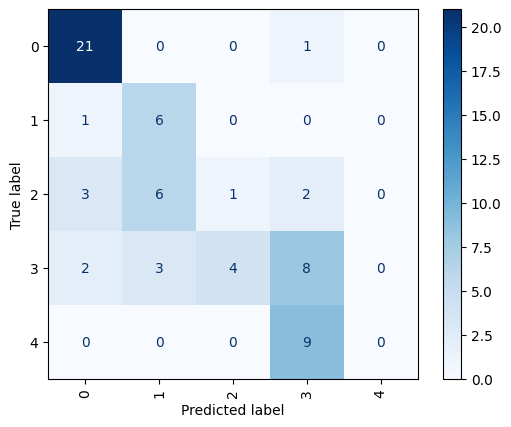

In [45]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())

display = ConfusionMatrixDisplay.from_predictions(y_true,y_pred,display_labels=[0,1,2,3,4], xticks_rotation=90, cmap="Blues");
display;  

In [216]:
# Seize of classes test data
zero_class = y_true.count(0)
first_class = y_true.count(1)
second_class = y_true.count(2)
th_class = y_true.count(3)
forth_class = y_true.count(4)

print("Size of test data for each class : \n0:",zero_class ,"\n1:", first_class ,"\n2:",second_class ,"\n3:",th_class ,"\n4:",forth_class)

Size of test data for each class : 
0: 22 
1: 9 
2: 12 
3: 16 
4: 8


In [253]:
#VISUALIZATION
# TEST DATA assign to 0 class (can check for any classes)
#for i, data in enumerate(iter(test_best_model_loader)): 
    #if y_pred[i] == 0: #to 0 class (change here to check)
        #fig, axs = plt.subplots(1,1, figsize=(3,4))
        #img = data[0][0][0]
        #axs.imshow(img)
        #axs.set_title("True Label : "+str(y_true[i])


In [295]:
# Print out the architecture and number of parameters.
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)
The model has 503,169 parameters.


# Fine-tune for a classification task with 5 classes

Additionally, fine-tuned models such as ResNet18, InceptionV3, and DenseNet were also employed to leverage their pre-trained weights and capture more intricate features of organoid structure and morphology over time.
This process aimed to capitalize on the pre-trained weights and architecture of ResNet18, which had been trained on a large-scale dataset, and adapt it to the specific task at hand.

The following key steps were implemented for fine-tuning the ResNet18 model:

1. Load the pre-trained ResNet18 model, benefiting from its already learned feature representations.
2. Freeze the weights of the initial layers, retaining the valuable knowledge captured by the pre-training phase.
3. Replace the final fully connected layer of ResNet18 with a new layer that matches the number of classes in the current dataset.
4. Define an appropriate loss function, such as cross-entropy loss, to compute the discrepancy between predicted logits and the ground truth labels.
5. Select an optimizer, such as stochastic gradient descent (SGD) or Adam, to facilitate weight updates during the fine-tuning process.
6. Iterate over the dataset for a specified number of epochs, passing the input images through the modified ResNet18 model.
7. Compute the loss by comparing the predicted logits with the ground truth labels.
8. Utilize backpropagation to calculate gradients and update the model's weights based on the computed loss.
9. Repeat steps 6 to 8 until the desired number of epochs has been completed.

By fine-tuning the ResNet18 model, the experiment aimed to capitalize on its pre-existing knowledge while adapting it to the unique characteristics of the current classification task. This approach has the potential to yield improved results compared to training the model from scratch, enabling efficient learning and better performance in the specific domain of interest.

**RESULT : Max accuracy near 60% for ResNet18 model**

**Discussion : does not represent sagnificant improves**

### ResNet18

In [226]:
#Libraries 
import torchvision.models as models

In [227]:
# Load the pre-trained ResNet18 model
resnet = models.resnet18(pretrained=True)

/home/meremina/mariias_env/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/meremina/mariias_env/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [228]:
# Print out the architecture and number of parameters.
# Instantiate the model.

print(resnet)
print(f"The model has {sum([x.nelement() for x in resnet.parameters()]):,} parameters.")

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [229]:
# Freeze all the layers in the pre-trained model
for param in resnet.parameters():
    param.requires_grad = False

In [230]:
# Modify the last fully-connected layer to have 5 output features instead of 1000
num_ftrs = resnet.fc.in_features
resnet.fc = nn.Linear(num_ftrs, 5)

In [231]:
# Modify the input 
# Print the original input size of the model
print(resnet.conv1.weight.size())

torch.Size([64, 3, 7, 7])


In [232]:
resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)

In [233]:
print(resnet.conv1.weight.size())

torch.Size([64, 1, 7, 7])


In [234]:
# Check modification
print(resnet)
print(f"The model has {sum([x.nelement() for x in resnet.parameters()]):,} parameters.")

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [235]:
# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(resnet.fc.parameters(), lr=0.001)


In [236]:
# Load the data and create a DataLoader
train_data = data_set_train
train_loader = torch.utils.data.DataLoader(train_data, batch_size=4, shuffle=True)

In [237]:
next(iter(data_set_train))[0].shape

torch.Size([1, 256, 256])

In [238]:
# Train the model for 300 epochs
for epoch in range(300):
    # Training phase
    model.train()
    running_loss = 0.0
    running_corrects = 0
    for i, data in enumerate(train_loader, 0):
        # Get the inputs and labels
        inputs, labels = data

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward + backward + optimize
        outputs = resnet(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # Track the loss and accuracy
        running_loss += loss.item()
        _, preds = torch.max(outputs, 1)
        running_corrects += torch.sum(preds == labels.data)

    # Calculate the epoch loss and accuracy for training data
    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)

    # Test phase
    model.eval()
    test_loss = 0.0
    test_corrects = 0
    with torch.no_grad():
        for data in test_loader:
            inputs, labels = data
            outputs = resnet(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            test_corrects += torch.sum(preds == labels.data)

    # Calculate the epoch loss and accuracy for test data
    test_epoch_loss = test_loss / len(test_loader.dataset)
    test_epoch_acc = test_corrects.double() / len(test_loader.dataset)

    # Print the epoch loss and accuracy for training and test data
    print("Epoch {}/{} - Train Loss: {:.4f}, Train Acc: {:.4f}, Test Loss: {:.4f}, Test Acc: {:.4f}"
          .format(epoch+1, 300, epoch_loss, epoch_acc, test_epoch_loss, test_epoch_acc))

Epoch 1/300 - Train Loss: 0.3436, Train Acc: 0.4297, Test Loss: 1.6092, Test Acc: 0.3284
Epoch 2/300 - Train Loss: 0.2864, Train Acc: 0.5361, Test Loss: 1.6968, Test Acc: 0.2537
Epoch 3/300 - Train Loss: 0.2518, Train Acc: 0.5970, Test Loss: 1.8010, Test Acc: 0.2537
Epoch 4/300 - Train Loss: 0.2550, Train Acc: 0.6008, Test Loss: 1.6109, Test Acc: 0.3433
Epoch 5/300 - Train Loss: 0.2267, Train Acc: 0.6464, Test Loss: 1.5833, Test Acc: 0.2537
Epoch 6/300 - Train Loss: 0.2327, Train Acc: 0.6236, Test Loss: 1.6253, Test Acc: 0.2537
Epoch 7/300 - Train Loss: 0.2433, Train Acc: 0.6312, Test Loss: 1.7554, Test Acc: 0.2537


KeyboardInterrupt: 

### InceptionV3

In [419]:
#Libraries 
import torchvision.models as models

In [420]:
# Load the pre-trained inception_v3 model
inception = models.inception_v3(pretrained=True)

In [421]:
# Print out the architecture and number of parameters.
# Instantiate the model.

print(inception)
print(f"The model has {sum([x.nelement() for x in inception.parameters()]):,} parameters.")

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [422]:
# Freeze all the layers in the pre-trained model
for param in inception.parameters():
    param.requires_grad = False

In [423]:
# Modify the last fully-connected layer to have 5 output features instead of 1000
num_ftrs = inception.fc.in_features
inception.fc = nn.Linear(num_ftrs, 5)

In [424]:
# Modify the input 
# Print the original input size of the model
print(inception.Conv2d_1a_3x3.conv.weight.size())

torch.Size([32, 3, 3, 3])


In [425]:
inception.Conv2d_1a_3x3 = nn.Conv2d(1, 32, kernel_size=3, stride=2, bias=False)

In [426]:
print(inception.Conv2d_1a_3x3.weight.size())

torch.Size([32, 1, 3, 3])


In [427]:
# Check modification
print(inception)
print(f"The model has {sum([x.nelement() for x in inception.parameters()]):,} parameters.")

Inception3(
  (Conv2d_1a_3x3): Conv2d(1, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(192, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
 

In [428]:
# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(inception.fc.parameters(), lr=0.001)

In [432]:
# Train the model for several epochs
for epoch in range(10):
    running_loss = 0.0
    for i, data in enumerate(train_loader):
        inputs, labels = data
        optimizer.zero_grad()
        print(inputs.shape)
        outputs = inception(inputs[0])#torch.squeeze(inputs[:, :1, :, :], dim=1)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    print('Epoch %d loss: %.3f' % (epoch + 1, running_loss / len(train_loader)))

torch.Size([4, 1, 256, 256])


RuntimeError: Calculated padded input size per channel: (1 x 127). Kernel size: (3 x 3). Kernel size can't be greater than actual input size

### DenseNe

In [434]:
import torchvision.models as models

In [435]:
# Load the pre-trained DenseNet model
densenet = models.densenet121(pretrained=True)

/home/meremina/mariias_env/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /home/meremina/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
76.0%IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [437]:
# Modify the input layer to accept single-channel images
densenet.features.conv0 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)

In [439]:
# Modify the final classification layer to output the correct number of classes
num_classes = 5
densenet.classifier = nn.Linear(in_features=1024, out_features=num_classes)

In [440]:
# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(densenet.parameters(), lr=0.001)

In [441]:
# Print out the architecture and number of parameters.
# Instantiate the model.

print(densenet)
print(f"The model has {sum([x.nelement() for x in densenet.parameters()]):,} parameters.")

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [ ]:
# Train the model for 300 epochs
for epoch in range(300):
    # Training phase
    model.train()
    running_loss = 0.0
    running_corrects = 0
    for i, data in enumerate(train_loader, 0):
        # Get the inputs and labels
        inputs, labels = data

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward + backward + optimize
        outputs = densenet(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # Track the loss and accuracy
        running_loss += loss.item()
        _, preds = torch.max(outputs, 1)
        running_corrects += torch.sum(preds == labels.data)

    # Calculate the epoch loss and accuracy for training data
    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)

    # Test phase
    model.eval()
    test_loss = 0.0
    test_corrects = 0
    with torch.no_grad():
        for data in test_loader:
            inputs, labels = data
            outputs = densenet(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            test_corrects += torch.sum(preds == labels.data)

    # Calculate the epoch loss and accuracy for test data
    test_epoch_loss = test_loss / len(test_loader.dataset)
    test_epoch_acc = test_corrects.double() / len(test_loader.dataset)

    # Print the epoch loss and accuracy for training and test data
    print("Epoch {}/{} - Train Loss: {:.4f}, Train Acc: {:.4f}, Test Loss: {:.4f}, Test Acc: {:.4f}"
          .format(epoch+1, 300, epoch_loss, epoch_acc, test_epoch_loss, test_epoch_acc))

# Experiments with adding each class gradually 

To experiment with adding each class gradually, starting with more distinguishable classes, you can modify the data loading process and gradually introduce classes with increasing levels of difficulty. Here's a pipline:

1. Start by loading the data for the most distinguishable classes(calss#1 and class#4). These classes should have clear and distinct patterns or features that are easier to learn for the model.Train the model using the loaded data and evaluate its performance on a separate test set.
2. Once the model has achieved satisfactory performance on the initial classes, gradually introduce additional classes with increasing difficulty(class#1,#3,#4).Load the data for the next set of classes and combine it with the previously loaded data.Train the model using the expanded dataset and evaluate its performance on the test set.

3. and 4. Repeat steps 1-2 for each subsequent set of classes until all classes have been added.Monitor the model's performance and analyze how the addition of new classes affects its accuracy and ability to generalize.

5. and 6. After observing the results from steps 1 to 4, it was decided to further split class 0 into two subclasses: "dead" and "empty". The motivation behind this decision is to better understand the influence of different class distributions on the model's training process and performance.

P.S To leverage the promising outcomes observed in the experiment, significant steps were taken to fine-tune the ResNet18 model. This process aimed to capitalize on the pre-trained weights and architecture of ResNet18, which had been trained on a large-scale dataset, and adapt it to the specific task at hand.


**RESULT :**

**1. Classification task with 2 classes : Test accuracy 100%**

**2. Classification task with 3 classes : Test accuracy 88%**

**3. Classification task with 4 classes : Test accuracy 69%**

**4. Classification task with 4 classes : Test accuracy 73%**

**5. Classification task with 5 classes : Test accuracy 51%**

**6. Classification task with 6 classes where class 0 was splitted in 2 independent classes "dead" and "empty" : Test accuracy 60%**

**7. Classification task with 6 classes where class 0 was splitted in 2 independent classes "dead" and "empty" : Test accuracy 66%**

**Discussion:**
**The outcome of the experiment indicated that the presence of the "dead" subclass had a more significant impact on the model's learning and introduced confusion during the training process. This suggests that the "dead" class, with its unique characteristics and patterns, posed a greater challenge for the model to learn and generalize effectively.**

**By analyzing the results, you can gain insights into the effect of class imbalance and the model's ability to handle varying levels of difficulty within the dataset. This understanding can guide further improvements in training strategies, such as data augmentation, class balancing techniques, or model adjustments, to enhance the model's performance in scenarios involving imbalanced and challenging class distributions.**

## 1. Classification task with 2 classes (orignal : class #1(modified) and #4)

In [67]:
# paths for data upload
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_0 = FILE_PATH + '/1.1' # same as class 1 but without 56.png and 57.png images
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/4.2' # same as class 4
# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_0,TRAIN_FEATURES_PATH_1]

In [68]:
PATHES_LIST

['mariias_env/1.1', 'mariias_env/4.2']

In [69]:
# Data set : train & test

In [70]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[0]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[0]))*0.2))

Class 1 : train :  26  test :  7


In [71]:
print("Class 2 : train : ",round(len(os.listdir(PATHES_LIST[1]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[1]))*0.2))

Class 2 : train :  37  test :  9


In [54]:
# Separate data to train and test data with ratio 0.8 in test data

In [83]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

16

In [84]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

63

In [76]:
# checking all labels in test data
classes = []
for i in range(len(data_set_test)):
    classes.append(data_set_test[i][1])
classes

[0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]

In [58]:
# Normalization 

In [77]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

In [78]:
mean = np.mean(test_Set)
mean

0.32194056042603086

In [79]:
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number

In [80]:
std = torch.std(torch.stack(test_image))
std

tensor(0.1545)

In [63]:
# TRANSFORMS & LOADER train & test data sets

In [64]:
# TRANSFORM test data : CenterCrop and Normalization 

In [81]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])

In [66]:
# TRANSFORM train data : Normalization

In [82]:
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

In [85]:
# Loader

In [86]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

In [87]:
# Architecture 

In [88]:
# CNN_LeNet : 
#  DISCRIPTOR : 

#2 CONV2 with STRIDE=2 AND PADDING=1 (it adds a border of 1 pixel of zeros around the input tensor before performing the convolution) \
#1st CONV2 :  ouput 6 channels \
#2st CONV2 :  ouput 16 channels 

In [89]:
class CNN_LeNet(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 2) # 2 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)
    
# Instantiate the model.
model_lenet = CNN_LeNet()

In [90]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=2, bias=True)
)
The model has 502,914 parameters.


###### Train

In [92]:
model_lenet = CNN_LeNet()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.59, Train Accuracy : 0.61, Test Loss : 0.50, Test Accuracy : 0.75
Number of Epoch : 1, Train Loss : 0.38, Train Accuracy : 0.88, Test Loss : 0.26, Test Accuracy : 1.00
Number of Epoch : 2, Train Loss : 0.24, Train Accuracy : 0.89, Test Loss : 0.33, Test Accuracy : 0.81
Number of Epoch : 3, Train Loss : 0.22, Train Accuracy : 0.95, Test Loss : 0.10, Test Accuracy : 1.00
Number of Epoch : 4, Train Loss : 0.15, Train Accuracy : 0.95, Test Loss : 0.06, Test Accuracy : 1.00
Number of Epoch : 5, Train Loss : 0.10, Train Accuracy : 0.97, Test Loss : 0.04, Test Accuracy : 1.00
Number of Epoch : 6, Train Loss : 0.03, Train Accuracy : 0.98, Test Loss : 0.01, Test Accuracy : 1.00
Number of Epoch : 7, Train Loss : 0.08, Train Accuracy : 0.97, Test Loss : 0.02, Test Accuracy : 1.00
Number of Epoch : 8, Train Loss : 0.05, Train Accuracy : 0.97, Test Loss : 0.04, Test Accuracy : 1.00
Number of Epoch : 9, Train Loss : 0.03, Train Accuracy : 0.98, Test Loss : 0.01, T

KeyboardInterrupt: 

#### Evaluation

In [93]:
#save model
torch.save(model_lenet.state_dict(),'mariias_env/model/model_LeNet_2_class.pt')

In [94]:
# try to upload model 
model = CNN_LeNet()
model.load_state_dict(torch.load('mariias_env/model/model_LeNet_2_class.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=2, bias=True)
)

In [95]:
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)

In [96]:
len(test_best_model_loader)

16

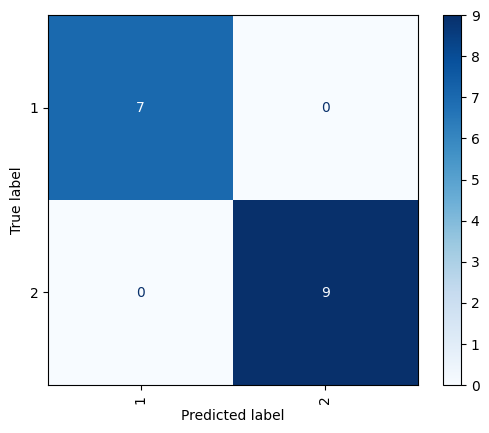

In [97]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())

display = ConfusionMatrixDisplay.from_predictions(y_true,y_pred,display_labels=[1,2], xticks_rotation=90, cmap="Blues");
display;  

## 2.Classification task with 3 classes (orignal : class #1(modified), #3 #4)

In [98]:
# paths for data upload
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_0 = FILE_PATH + '/1.1' # same as class 1 but without 56.png and 57.png images
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/4' # same as class 4
TRAIN_FEATURES_PATH_2 = FILE_PATH + '/3' # class 3
# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_0,TRAIN_FEATURES_PATH_1,TRAIN_FEATURES_PATH_2]

In [99]:
PATHES_LIST

['mariias_env/1.1', 'mariias_env/4', 'mariias_env/3']

In [100]:
# Data set : train & test

In [101]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[0]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[0]))*0.2))

Class 1 : train :  26  test :  7


In [102]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[1]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[1]))*0.2))

Class 1 : train :  37  test :  9


In [103]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[2]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[2]))*0.2))

Class 1 : train :  68  test :  17


In [107]:
# Separate data to train and test data with ratio 0.8 in test data

In [121]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

33

In [122]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

131

In [110]:
# checking all labels in test data
classes = []
for i in range(len(data_set_test)):
    classes.append(data_set_test[i][1])
classes

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2]

In [111]:
# Normalization 

In [112]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

In [113]:
mean = np.mean(test_Set)
mean

0.3395680331319343

In [114]:
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number

In [115]:
std = torch.std(torch.stack(test_image))
std

tensor(0.1549)

In [116]:
# TRANSFORMS & LOADER train & test data sets

In [117]:
# TRANSFORM test data : CenterCrop and Normalization 

In [118]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])

In [119]:
# TRANSFORM train data : Normalization

In [120]:
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

In [124]:
# Loader

In [123]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

In [125]:
# Architecture 

In [126]:
# CNN_LeNet : 
#  DISCRIPTOR : 

#2 CONV2 with STRIDE=2 AND PADDING=1 (it adds a border of 1 pixel of zeros around the input tensor before performing the convolution) \
#1st CONV2 :  ouput 6 channels \
#2st CONV2 :  ouput 16 channels 

In [127]:
class CNN_LeNet(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 3) # 3 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)
    
# Instantiate the model.
model_lenet = CNN_LeNet()

In [128]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=3, bias=True)
)
The model has 502,999 parameters.


In [129]:
model_lenet = CNN_LeNet()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.02, Train Accuracy : 0.52, Test Loss : 0.98, Test Accuracy : 0.55
Number of Epoch : 1, Train Loss : 0.92, Train Accuracy : 0.62, Test Loss : 0.97, Test Accuracy : 0.61
Number of Epoch : 2, Train Loss : 0.81, Train Accuracy : 0.67, Test Loss : 0.86, Test Accuracy : 0.58
Number of Epoch : 3, Train Loss : 0.73, Train Accuracy : 0.71, Test Loss : 0.71, Test Accuracy : 0.73
Number of Epoch : 4, Train Loss : 0.68, Train Accuracy : 0.73, Test Loss : 0.73, Test Accuracy : 0.70
Number of Epoch : 5, Train Loss : 0.67, Train Accuracy : 0.69, Test Loss : 0.67, Test Accuracy : 0.64
Number of Epoch : 6, Train Loss : 0.56, Train Accuracy : 0.76, Test Loss : 0.62, Test Accuracy : 0.76
Number of Epoch : 7, Train Loss : 0.59, Train Accuracy : 0.76, Test Loss : 0.56, Test Accuracy : 0.79
Number of Epoch : 8, Train Loss : 0.46, Train Accuracy : 0.81, Test Loss : 0.55, Test Accuracy : 0.76
Number of Epoch : 9, Train Loss : 0.48, Train Accuracy : 0.79, Test Loss : 0.55, T

In [130]:
class CNN_(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,16, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(16, 32, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(32 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 3) # 3 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [131]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_(
  (conv2d1): Conv2d(1, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=8192, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=3, bias=True)
)
The model has 998,379 parameters.


In [132]:
model_lenet = CNN_()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.00, Train Accuracy : 0.52, Test Loss : 0.98, Test Accuracy : 0.52
Number of Epoch : 1, Train Loss : 0.88, Train Accuracy : 0.59, Test Loss : 0.82, Test Accuracy : 0.61
Number of Epoch : 2, Train Loss : 0.81, Train Accuracy : 0.62, Test Loss : 0.71, Test Accuracy : 0.70
Number of Epoch : 3, Train Loss : 0.69, Train Accuracy : 0.73, Test Loss : 1.00, Test Accuracy : 0.52
Number of Epoch : 4, Train Loss : 0.75, Train Accuracy : 0.60, Test Loss : 0.66, Test Accuracy : 0.82
Number of Epoch : 5, Train Loss : 0.56, Train Accuracy : 0.74, Test Loss : 0.59, Test Accuracy : 0.76
Number of Epoch : 6, Train Loss : 0.47, Train Accuracy : 0.80, Test Loss : 0.67, Test Accuracy : 0.64
Number of Epoch : 7, Train Loss : 0.47, Train Accuracy : 0.82, Test Loss : 0.45, Test Accuracy : 0.79
Number of Epoch : 8, Train Loss : 0.43, Train Accuracy : 0.81, Test Loss : 0.40, Test Accuracy : 0.82
Number of Epoch : 9, Train Loss : 0.37, Train Accuracy : 0.85, Test Loss : 0.45, T

In [133]:
class CNN_LeNet_drop_out(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet_drop_out, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 3) # 3 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [134]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet_drop_out()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=3, bias=True)
)
The model has 502,999 parameters.


In [135]:
model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.05, Train Accuracy : 0.50, Test Loss : 1.02, Test Accuracy : 0.55
Number of Epoch : 1, Train Loss : 0.93, Train Accuracy : 0.55, Test Loss : 0.99, Test Accuracy : 0.52
Number of Epoch : 2, Train Loss : 0.84, Train Accuracy : 0.60, Test Loss : 0.97, Test Accuracy : 0.42
Number of Epoch : 3, Train Loss : 0.78, Train Accuracy : 0.67, Test Loss : 0.79, Test Accuracy : 0.64
Number of Epoch : 4, Train Loss : 0.70, Train Accuracy : 0.72, Test Loss : 0.70, Test Accuracy : 0.70
Number of Epoch : 5, Train Loss : 0.61, Train Accuracy : 0.73, Test Loss : 0.77, Test Accuracy : 0.67
Number of Epoch : 6, Train Loss : 0.62, Train Accuracy : 0.72, Test Loss : 0.92, Test Accuracy : 0.61
Number of Epoch : 7, Train Loss : 0.60, Train Accuracy : 0.76, Test Loss : 0.63, Test Accuracy : 0.73
Number of Epoch : 8, Train Loss : 0.48, Train Accuracy : 0.84, Test Loss : 0.60, Test Accuracy : 0.79
Number of Epoch : 9, Train Loss : 0.51, Train Accuracy : 0.79, Test Loss : 0.59, T

In [136]:
#save model
torch.save(model_lenet.state_dict(),'mariias_env/model/model_LeNet_drop_out_3_class.pt')

In [137]:
# try to upload model 
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/model_LeNet_drop_out_3_class.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=3, bias=True)
)

In [138]:
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)

In [140]:
len(test_best_model_loader)

33

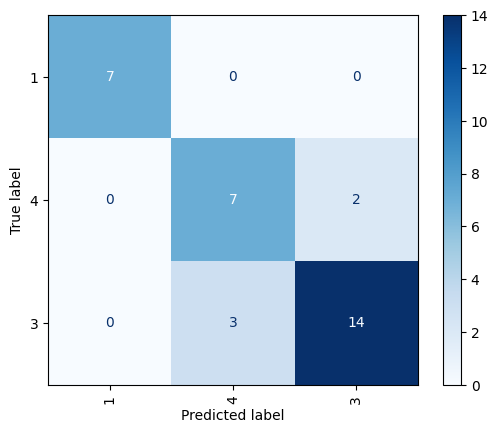

In [147]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())

display = ConfusionMatrixDisplay.from_predictions(y_true,y_pred,display_labels=[1,4,3], xticks_rotation=90, cmap="Blues");
display;  

## 3.Classification task with 4 classes (orignal : class #1(modified),#2,#3 #4)

In [239]:
# paths for data upload
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_0 = FILE_PATH + '/1.1' # same as class 1 but without 56.png and 57.png images
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/2' # same as class 2
TRAIN_FEATURES_PATH_2 = FILE_PATH + '/3' # class 3
TRAIN_FEATURES_PATH_3 = FILE_PATH + '/4' # class 4
# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_0,TRAIN_FEATURES_PATH_1,TRAIN_FEATURES_PATH_2,TRAIN_FEATURES_PATH_3]

In [240]:
PATHES_LIST

['mariias_env/1.1', 'mariias_env/2', 'mariias_env/3', 'mariias_env/4']

In [241]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[0]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[0]))*0.2))

Class 1 : train :  26  test :  7


In [242]:
print("Class 2 : train : ",round(len(os.listdir(PATHES_LIST[1]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[1]))*0.2))

Class 2 : train :  46  test :  12


In [243]:
print("Class 3 : train : ",round(len(os.listdir(PATHES_LIST[2]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[2]))*0.2))

Class 3 : train :  68  test :  17


In [244]:
print("Class 4 : train : ",round(len(os.listdir(PATHES_LIST[3]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[3]))*0.2))

Class 4 : train :  37  test :  9


In [247]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

45

In [248]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

177

In [249]:
# checking all labels in test data
classes = []
for i in range(len(data_set_test)):
    classes.append(data_set_test[i][1])
classes

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3]

In [250]:
# Normalization

In [251]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

In [252]:
mean = np.mean(test_Set)
mean

0.33254504616314406

In [253]:
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number

In [254]:
std = torch.std(torch.stack(test_image))
std

tensor(0.1462)

In [255]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])

In [256]:
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

In [257]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

### Models and training

In [167]:
class CNN_LeNet(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 4) # 3 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)
    
# Instantiate the model.
model_lenet = CNN_LeNet()

In [168]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=4, bias=True)
)
The model has 503,084 parameters.


In [169]:
model_lenet = CNN_LeNet()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.35, Train Accuracy : 0.38, Test Loss : 1.34, Test Accuracy : 0.38
Number of Epoch : 1, Train Loss : 1.33, Train Accuracy : 0.38, Test Loss : 1.42, Test Accuracy : 0.38
Number of Epoch : 2, Train Loss : 1.30, Train Accuracy : 0.39, Test Loss : 1.38, Test Accuracy : 0.38
Number of Epoch : 3, Train Loss : 1.28, Train Accuracy : 0.37, Test Loss : 1.36, Test Accuracy : 0.38
Number of Epoch : 4, Train Loss : 1.25, Train Accuracy : 0.46, Test Loss : 1.47, Test Accuracy : 0.27
Number of Epoch : 5, Train Loss : 1.19, Train Accuracy : 0.47, Test Loss : 1.28, Test Accuracy : 0.27
Number of Epoch : 6, Train Loss : 1.18, Train Accuracy : 0.44, Test Loss : 1.31, Test Accuracy : 0.29
Number of Epoch : 7, Train Loss : 1.19, Train Accuracy : 0.43, Test Loss : 1.34, Test Accuracy : 0.27
Number of Epoch : 8, Train Loss : 1.18, Train Accuracy : 0.47, Test Loss : 1.30, Test Accuracy : 0.27
Number of Epoch : 9, Train Loss : 1.14, Train Accuracy : 0.48, Test Loss : 1.27, T

In [170]:
class CNN_LeNet_drop_out(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet_drop_out, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 4) # 4 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [171]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet_drop_out()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=4, bias=True)
)
The model has 503,084 parameters.


In [173]:
#model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.75, Train Accuracy : 0.66, Test Loss : 0.81, Test Accuracy : 0.53
Number of Epoch : 1, Train Loss : 0.63, Train Accuracy : 0.70, Test Loss : 0.80, Test Accuracy : 0.58
Number of Epoch : 2, Train Loss : 0.62, Train Accuracy : 0.68, Test Loss : 0.79, Test Accuracy : 0.60
Number of Epoch : 3, Train Loss : 0.70, Train Accuracy : 0.68, Test Loss : 0.78, Test Accuracy : 0.60
Number of Epoch : 4, Train Loss : 0.69, Train Accuracy : 0.67, Test Loss : 0.72, Test Accuracy : 0.67
Number of Epoch : 5, Train Loss : 0.66, Train Accuracy : 0.69, Test Loss : 0.80, Test Accuracy : 0.62
Number of Epoch : 6, Train Loss : 0.62, Train Accuracy : 0.73, Test Loss : 0.77, Test Accuracy : 0.53
Number of Epoch : 7, Train Loss : 0.64, Train Accuracy : 0.71, Test Loss : 0.85, Test Accuracy : 0.58
Number of Epoch : 8, Train Loss : 0.67, Train Accuracy : 0.68, Test Loss : 0.82, Test Accuracy : 0.49
Number of Epoch : 9, Train Loss : 0.66, Train Accuracy : 0.72, Test Loss : 0.82, T

In [174]:
#save model
torch.save(model_lenet.state_dict(),'mariias_env/model/model_LeNet_drop_out_4_class.pt')

In [175]:
# try to upload model 
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/model_LeNet_drop_out_4_class.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=4, bias=True)
)

In [176]:
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)

In [177]:
len(test_best_model_loader)

45

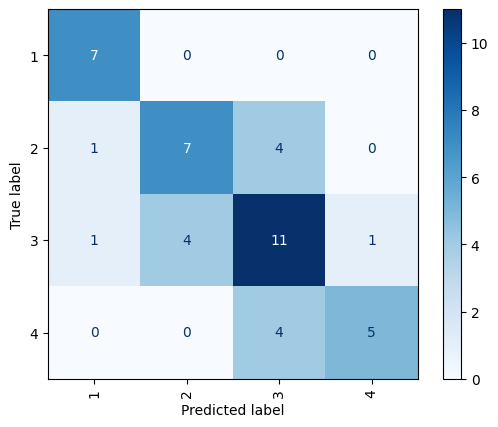

In [178]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())

display = ConfusionMatrixDisplay.from_predictions(y_true,y_pred,display_labels=[1,2,3,4], xticks_rotation=90, cmap="Blues");
display; 

In [179]:
# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.59, Train Accuracy : 0.74, Test Loss : 0.82, Test Accuracy : 0.60
Number of Epoch : 1, Train Loss : 0.54, Train Accuracy : 0.72, Test Loss : 0.64, Test Accuracy : 0.71
Number of Epoch : 2, Train Loss : 0.50, Train Accuracy : 0.76, Test Loss : 0.60, Test Accuracy : 0.71
Number of Epoch : 3, Train Loss : 0.57, Train Accuracy : 0.69, Test Loss : 0.70, Test Accuracy : 0.62
Number of Epoch : 4, Train Loss : 0.52, Train Accuracy : 0.77, Test Loss : 0.61, Test Accuracy : 0.62
Number of Epoch : 5, Train Loss : 0.53, Train Accuracy : 0.74, Test Loss : 0.72, Test Accuracy : 0.64
Number of Epoch : 6, Train Loss : 0.59, Train Accuracy : 0.77, Test Loss : 0.77, Test Accuracy : 0.58
Number of Epoch : 7, Train Loss : 0.63, Train Accuracy : 0.74, Test Loss : 0.73, Test Accuracy : 0.58
Number of Epoch : 8, Train Loss : 0.53, Train Accuracy : 0.76, Test Loss : 0.69, Test Accuracy : 0.64
Number of Epoch : 9, Train Loss : 0.65, Train Accuracy : 0.74, Test Loss : 0.65, T

In [180]:
#save model
torch.save(model_lenet.state_dict(),'mariias_env/model/model_LeNet_drop_out_4_class_ac73.pt')

In [181]:
# try to upload model 
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/model_LeNet_drop_out_4_class.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=4, bias=True)
)

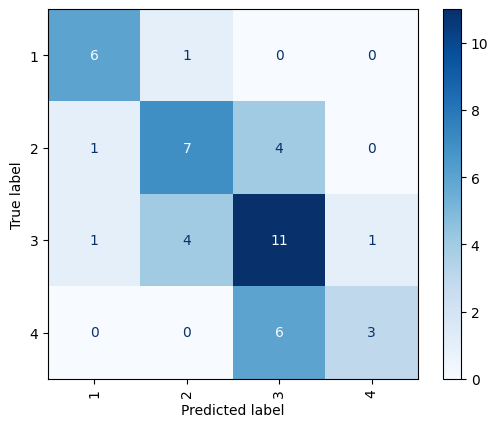

In [182]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())

display = ConfusionMatrixDisplay.from_predictions(y_true,y_pred,display_labels=[1,2,3,4], xticks_rotation=90, cmap="Blues");
display;

In [184]:
# Train the model
# batch size 4
epochs = 30
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.48, Train Accuracy : 0.80, Test Loss : 0.75, Test Accuracy : 0.67
Number of Epoch : 1, Train Loss : 0.37, Train Accuracy : 0.84, Test Loss : 0.79, Test Accuracy : 0.71
Number of Epoch : 2, Train Loss : 0.37, Train Accuracy : 0.86, Test Loss : 0.79, Test Accuracy : 0.73
Number of Epoch : 3, Train Loss : 0.39, Train Accuracy : 0.87, Test Loss : 0.70, Test Accuracy : 0.69
Number of Epoch : 4, Train Loss : 0.45, Train Accuracy : 0.79, Test Loss : 0.48, Test Accuracy : 0.76
Number of Epoch : 5, Train Loss : 0.45, Train Accuracy : 0.82, Test Loss : 1.09, Test Accuracy : 0.64
Number of Epoch : 6, Train Loss : 0.43, Train Accuracy : 0.86, Test Loss : 0.61, Test Accuracy : 0.71
Number of Epoch : 7, Train Loss : 0.38, Train Accuracy : 0.84, Test Loss : 0.68, Test Accuracy : 0.71
Number of Epoch : 8, Train Loss : 0.45, Train Accuracy : 0.84, Test Loss : 0.66, Test Accuracy : 0.69
Number of Epoch : 9, Train Loss : 0.44, Train Accuracy : 0.80, Test Loss : 0.72, T

### ResNet18 fine-tune

In [277]:
#Libraries 
import torchvision.models as models

In [278]:
# Load the pre-trained ResNet18 model
resnet = models.resnet18(pretrained=True)

In [279]:
# Print out the architecture and number of parameters.
# Instantiate the model.

print(resnet)
print(f"The model has {sum([x.nelement() for x in resnet.parameters()]):,} parameters.")

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [280]:
# Freeze all the layers in the pre-trained model
for param in resnet.parameters():
    param.requires_grad = False

In [281]:
# Modify the last fully-connected layer to have 5 output features instead of 1000
num_ftrs = resnet.fc.in_features
resnet.fc = nn.Linear(num_ftrs, 4)

In [282]:
resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)

In [283]:
# Check modification
print(resnet)
print(f"The model has {sum([x.nelement() for x in resnet.parameters()]):,} parameters.")

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [290]:
# Define the loss function and optimizer
criterion = F.cross_entropy #nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(resnet.fc.parameters(), lr=0.001)

In [291]:
# Train the model for 300 epochs
for epoch in range(300):
    # Training phase
    model.train()
    running_loss = 0.0
    running_corrects = 0
    for i, data in enumerate(train_loader, 0):
        # Get the inputs and labels
        inputs, labels = data

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward + backward + optimize
        outputs = resnet(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # Track the loss and accuracy
        running_loss += loss.item()
        _, preds = torch.max(outputs, 1)
        running_corrects += torch.sum(preds == labels.data)

    # Calculate the epoch loss and accuracy for training data
    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)

    # Test phase
    model.eval()
    test_loss = 0.0
    test_corrects = 0
    with torch.no_grad():
        for data in test_loader:
            inputs, labels = data
            outputs = resnet(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            test_corrects += torch.sum(preds == labels.data)

    # Calculate the epoch loss and accuracy for test data
    test_epoch_loss = test_loss / len(test_loader.dataset)
    test_epoch_acc = test_corrects.double() / len(test_loader.dataset)

    # Print the epoch loss and accuracy for training and test data
    print("Epoch {}/{} - Train Loss: {:.4f}, Train Acc: {:.4f}, Test Loss: {:.4f}, Test Acc: {:.4f}"
          .format(epoch+1, 300, epoch_loss, epoch_acc, test_epoch_loss, test_epoch_acc))

Epoch 1/300 - Train Loss: 118.3453, Train Acc: 0.4689, Test Loss: 638.4807, Test Acc: 0.3778
Epoch 2/300 - Train Loss: 124.0097, Train Acc: 0.4011, Test Loss: 624.9498, Test Acc: 0.3778
Epoch 3/300 - Train Loss: 116.0005, Train Acc: 0.4407, Test Loss: 610.4467, Test Acc: 0.3778
Epoch 4/300 - Train Loss: 114.7444, Train Acc: 0.4463, Test Loss: 595.9289, Test Acc: 0.3778
Epoch 5/300 - Train Loss: 110.0791, Train Acc: 0.4463, Test Loss: 583.0782, Test Acc: 0.3778
Epoch 6/300 - Train Loss: 115.2912, Train Acc: 0.3616, Test Loss: 572.5500, Test Acc: 0.3778
Epoch 7/300 - Train Loss: 113.3028, Train Acc: 0.4011, Test Loss: 559.5931, Test Acc: 0.3778
Epoch 8/300 - Train Loss: 110.9457, Train Acc: 0.4181, Test Loss: 552.1474, Test Acc: 0.3778
Epoch 9/300 - Train Loss: 97.1114, Train Acc: 0.4689, Test Loss: 545.0573, Test Acc: 0.3778
Epoch 10/300 - Train Loss: 103.0728, Train Acc: 0.4972, Test Loss: 537.8136, Test Acc: 0.3778
Epoch 11/300 - Train Loss: 101.7531, Train Acc: 0.4463, Test Loss: 530

KeyboardInterrupt: 

## 4.Classification task with 5 classes (orignal : class #0, #1(modified),#2,#3 #4)

In [200]:
# paths for data upload
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_0 = FILE_PATH + '/0' # same as class 1 but without 56.png and 57.png images
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/1.1' # same as class 2
TRAIN_FEATURES_PATH_2 = FILE_PATH + '/2' # class 3
TRAIN_FEATURES_PATH_3 = FILE_PATH + '/3' # class 4
TRAIN_FEATURES_PATH_4 = FILE_PATH + '/4' # class 4
# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_0,TRAIN_FEATURES_PATH_1,TRAIN_FEATURES_PATH_2,TRAIN_FEATURES_PATH_3,TRAIN_FEATURES_PATH_4]

In [201]:
PATHES_LIST

['mariias_env/0',
 'mariias_env/1.1',
 'mariias_env/2',
 'mariias_env/3',
 'mariias_env/4']

In [202]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[0]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[0]))*0.2))

Class 1 : train :  86  test :  22


In [203]:
print("Class 2 : train : ",round(len(os.listdir(PATHES_LIST[1]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[1]))*0.2))

Class 2 : train :  26  test :  7


In [204]:
print("Class 3 : train : ",round(len(os.listdir(PATHES_LIST[2]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[2]))*0.2))

Class 3 : train :  46  test :  12


In [205]:
print("Class 4 : train : ",round(len(os.listdir(PATHES_LIST[3]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[3]))*0.2))

Class 4 : train :  68  test :  17


In [206]:
print("Class 5 : train : ",round(len(os.listdir(PATHES_LIST[4]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[4]))*0.2))

Class 5 : train :  37  test :  9


In [219]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

67

In [220]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

263

In [212]:
# checking all labels in test data
classes = []
for i in range(len(data_set_test)):
    classes.append(data_set_test[i][1])
classes

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4]

In [213]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

In [214]:
mean = np.mean(test_Set)
mean

0.3445345679290961

In [215]:
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number

In [216]:
std = torch.std(torch.stack(test_image))
std

tensor(0.1626)

In [217]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])

In [218]:
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

In [221]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

In [222]:
class CNN_LeNet_drop_out(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet_drop_out, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 5) # 5 classes))

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [223]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet_drop_out()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)
The model has 503,169 parameters.


In [225]:
#model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.47, Train Accuracy : 0.81, Test Loss : 2.93, Test Accuracy : 0.51
Number of Epoch : 1, Train Loss : 0.50, Train Accuracy : 0.80, Test Loss : 2.11, Test Accuracy : 0.55
Number of Epoch : 2, Train Loss : 0.52, Train Accuracy : 0.81, Test Loss : 2.86, Test Accuracy : 0.45
Number of Epoch : 3, Train Loss : 0.41, Train Accuracy : 0.82, Test Loss : 2.79, Test Accuracy : 0.51


KeyboardInterrupt: 

## 5.Classification task with 6 classes (classes: dead and empty, #1,#2,#3 #4 )

In [7]:
# paths for data upload data known for sure
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_01 = FILE_PATH + '/empty' #empty
TRAIN_FEATURES_PATH_02 = FILE_PATH + '/dead' #dead
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/11' # class 1 but without 56.png and 57.png images
TRAIN_FEATURES_PATH_2 = FILE_PATH + '/22' # class 3
TRAIN_FEATURES_PATH_3 = FILE_PATH + '/33' # class 4
TRAIN_FEATURES_PATH_4 = FILE_PATH + '/44' # class 4
# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_01,TRAIN_FEATURES_PATH_02,TRAIN_FEATURES_PATH_1,TRAIN_FEATURES_PATH_2,TRAIN_FEATURES_PATH_3,TRAIN_FEATURES_PATH_4]

In [8]:
PATHES_LIST

['mariias_env/empty',
 'mariias_env/dead',
 'mariias_env/11',
 'mariias_env/22',
 'mariias_env/33',
 'mariias_env/44']

In [416]:
#checking size
folder_path = TRAIN_FEATURES_PATH_4
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]


In [417]:
for file in image_files:
    img_path = os.path.join(folder_path, file)
    img = cv2.imread(img_path)
    height, width, channels = img.shape
    print(f"{file}: {height} x {width} x {channels}")


281.png: 350 x 350 x 3
309.png: 350 x 350 x 3
88.png: 350 x 350 x 3
275.png: 350 x 350 x 3
328.png: 350 x 350 x 3
285.png: 350 x 350 x 3
287.png: 350 x 350 x 3
262.png: 350 x 350 x 3
62.png: 350 x 350 x 3
13.png: 350 x 350 x 3
90.png: 350 x 350 x 3
263.png: 350 x 350 x 3
307.png: 350 x 350 x 3
316.png: 350 x 350 x 3
329.png: 350 x 350 x 3
286.png: 350 x 350 x 3
294.png: 350 x 350 x 3
64.png: 350 x 350 x 3
84.png: 350 x 350 x 3
279.png: 350 x 350 x 3
264.png: 350 x 350 x 3
89.png: 350 x 350 x 3
254.png: 350 x 350 x 3
65.png: 350 x 350 x 3
86.png: 350 x 350 x 3
66.png: 350 x 350 x 3
308.png: 350 x 350 x 3
112.png: 350 x 350 x 3
49.png: 350 x 350 x 3
280.png: 350 x 350 x 3


In [418]:
print("Class empty : train : ",round(len(os.listdir(PATHES_LIST[0]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[0]))*0.2))

Class empty : train :  33  test :  8


In [419]:
print("Class dead : train : ",round(len(os.listdir(PATHES_LIST[1]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[1]))*0.2))

Class dead : train :  22  test :  5


In [420]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[2]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[2]))*0.2))

Class 1 : train :  88  test :  22


In [421]:
print("Class 2 : train : ",round(len(os.listdir(PATHES_LIST[3]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[3]))*0.2))

Class 2 : train :  8  test :  2


In [422]:
print("Class 3 : train : ",round(len(os.listdir(PATHES_LIST[4]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[4]))*0.2))

Class 3 : train :  82  test :  20


In [423]:
print("Class 4 : train : ",round(len(os.listdir(PATHES_LIST[5]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[5]))*0.2))

Class 4 : train :  24  test :  6


In [20]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

63

In [21]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

257

In [427]:
# checking all labels in train data
classes = []
for i in range(len(data_set_train)):
    classes.append(data_set_train[i][1])
classes

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,


In [365]:
# checking all labels in test data
classes = []
for i in range(len(data_set_test)):
    classes.append(data_set_test[i][1])
classes

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 5,
 5,
 5,
 5,
 5,
 5]

In [14]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

In [15]:
mean = np.mean(test_Set)
mean

0.3508294261267213

In [16]:
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number

In [17]:
std = torch.std(torch.stack(test_image))
std

tensor(0.1701)

In [18]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])

In [19]:
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

In [22]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

In [437]:
class CNN_LeNet_drop_out(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet_drop_out, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 6) # 6 classes))1,2,3,4 + empty and dead

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [438]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet_drop_out()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=6, bias=True)
)
The model has 503,254 parameters.


In [439]:
#model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.62, Train Accuracy : 0.31, Test Loss : 1.50, Test Accuracy : 0.35
Number of Epoch : 1, Train Loss : 1.49, Train Accuracy : 0.41, Test Loss : 1.33, Test Accuracy : 0.51
Number of Epoch : 2, Train Loss : 1.39, Train Accuracy : 0.47, Test Loss : 1.20, Test Accuracy : 0.51
Number of Epoch : 3, Train Loss : 1.33, Train Accuracy : 0.48, Test Loss : 1.27, Test Accuracy : 0.49
Number of Epoch : 4, Train Loss : 1.29, Train Accuracy : 0.52, Test Loss : 1.34, Test Accuracy : 0.54
Number of Epoch : 5, Train Loss : 1.24, Train Accuracy : 0.57, Test Loss : 1.36, Test Accuracy : 0.48
Number of Epoch : 6, Train Loss : 1.17, Train Accuracy : 0.60, Test Loss : 1.32, Test Accuracy : 0.54
Number of Epoch : 7, Train Loss : 1.15, Train Accuracy : 0.58, Test Loss : 1.27, Test Accuracy : 0.57
Number of Epoch : 8, Train Loss : 1.13, Train Accuracy : 0.60, Test Loss : 1.76, Test Accuracy : 0.40
Number of Epoch : 9, Train Loss : 1.16, Train Accuracy : 0.60, Test Loss : 1.40, T

KeyboardInterrupt: 

In [440]:
#save model
torch.save(model_lenet.state_dict(),'mariias_env/model/model_LeNet_drop_out_5_class_ac60_empty_dead.pt')

In [442]:
# try to upload model 
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/model_LeNet_drop_out_5_class_ac60_empty_dead.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=6, bias=True)
)

In [443]:
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)

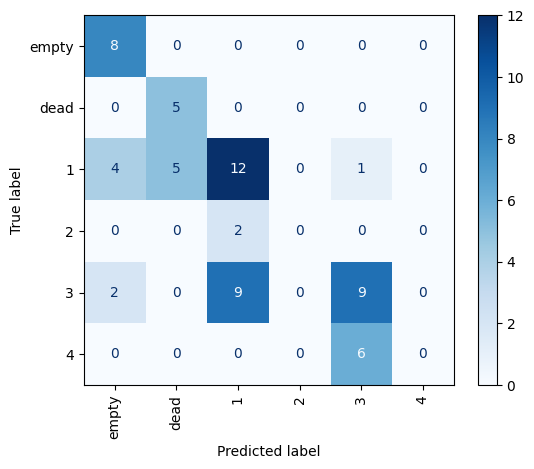

In [446]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())
display_labels = [str("empty"), str("dead"), str(1),str(2), str(3), str(4)]
display = ConfusionMatrixDisplay.from_predictions(y_true, y_pred, display_labels=display_labels, xticks_rotation=90, cmap="Blues")
display;

#display = ConfusionMatrixDisplay.from_predictions(y_true,y_pred,display_labels=[str("empty"),str("dead"),2,3,4], xticks_rotation=90, cmap="Blues");
#display;

In [447]:
# architecture of CNN
class ConvNet2(nn.Module):
    def __init__(self):
        super().__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.batchnorm1 = torch.nn.BatchNorm2d(6, eps=1e-05, momentum=0.1)
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.batchnorm2 = torch.nn.BatchNorm2d(16, eps=1e-05, momentum=0.1)
        self.fc1 = nn.Linear(16 * 16 * 16 , 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 6) # 6 classes 
    
    def forward(self, x):
        #torch.nn.functional.max_pool2d(input, kernel_size)
        # used batch normalization and dropout to protect against overfitting
        x = F.max_pool2d(F.relu(self.batchnorm1(self.conv2d1(x))), 2) # used batch normlalization after convolution but before non-linear function
        x = F.max_pool2d(F.relu(self.batchnorm2(self.conv2d2(x))), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    # function for future prediction
    def predict(self, x): 
        logits = self.forward(x)
        return F.softmax(logits)

In [448]:
model_lenet = ConvNet2()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

ConvNet2(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (batchnorm1): BatchNorm2d(6, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (batchnorm2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=6, bias=True)
)
The model has 503,298 parameters.


In [450]:
# Train the model
# batch size 4
epochs = 200
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.91, Train Accuracy : 0.68, Test Loss : 2.22, Test Accuracy : 0.22
Number of Epoch : 1, Train Loss : 0.79, Train Accuracy : 0.71, Test Loss : 2.06, Test Accuracy : 0.19
Number of Epoch : 2, Train Loss : 0.78, Train Accuracy : 0.70, Test Loss : 2.27, Test Accuracy : 0.32
Number of Epoch : 3, Train Loss : 0.81, Train Accuracy : 0.66, Test Loss : 2.35, Test Accuracy : 0.27
Number of Epoch : 4, Train Loss : 0.85, Train Accuracy : 0.65, Test Loss : 2.39, Test Accuracy : 0.33
Number of Epoch : 5, Train Loss : 0.83, Train Accuracy : 0.69, Test Loss : 2.03, Test Accuracy : 0.29


KeyboardInterrupt: 

In [23]:
import torchvision.models as models

# Load pre-trained ResNet18 model
model = models.resnet18(pretrained=True)

/home/meremina/mariias_env/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/meremina/mariias_env/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [24]:
import torch.nn as nn

model.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
num_ftrs = model.fc.in_features
# add 2 fc laers with dropout at the end
model.fc = nn.Sequential(
    nn.Linear(num_ftrs, 512),
    nn.ReLU(),
    nn.Dropout(p=0.5),
    nn.Linear(512, 256),
    nn.ReLU(),
    nn.Dropout(p=0.5),
    nn.Linear(256, 6)
)


In [25]:
# Freeze layers except for the final layer and dropout layer
for name, param in model.named_parameters():
    if 'fc' in name:
        param.requires_grad = True
    else:
        param.requires_grad = False



In [26]:
print(model)
print(f"The model has {sum([x.nelement() for x in model.parameters()]):,} parameters.")

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [27]:
# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters())


In [28]:
epochs = 200

learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model.parameters(), lr=learning_rate)
train_model(model, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.77, Train Accuracy : 0.30, Test Loss : 1.68, Test Accuracy : 0.32
Number of Epoch : 1, Train Loss : 1.60, Train Accuracy : 0.36, Test Loss : 1.56, Test Accuracy : 0.37
Number of Epoch : 2, Train Loss : 1.53, Train Accuracy : 0.38, Test Loss : 1.58, Test Accuracy : 0.33
Number of Epoch : 3, Train Loss : 1.50, Train Accuracy : 0.37, Test Loss : 1.63, Test Accuracy : 0.29
Number of Epoch : 4, Train Loss : 1.44, Train Accuracy : 0.43, Test Loss : 1.64, Test Accuracy : 0.27
Number of Epoch : 5, Train Loss : 1.40, Train Accuracy : 0.45, Test Loss : 1.59, Test Accuracy : 0.35
Number of Epoch : 6, Train Loss : 1.38, Train Accuracy : 0.44, Test Loss : 1.66, Test Accuracy : 0.22
Number of Epoch : 7, Train Loss : 1.39, Train Accuracy : 0.45, Test Loss : 1.64, Test Accuracy : 0.33
Number of Epoch : 8, Train Loss : 1.36, Train Accuracy : 0.47, Test Loss : 1.63, Test Accuracy : 0.22
Number of Epoch : 9, Train Loss : 1.36, Train Accuracy : 0.46, Test Loss : 2.01, T

In [29]:
#save model
torch.save(model.state_dict(),'mariias_env/model/resnet18_6_class_ac38_empty_dead.pt')

In [31]:
model.load_state_dict(torch.load('mariias_env/model/resnet18_6_class_ac38_empty_dead.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [32]:
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)

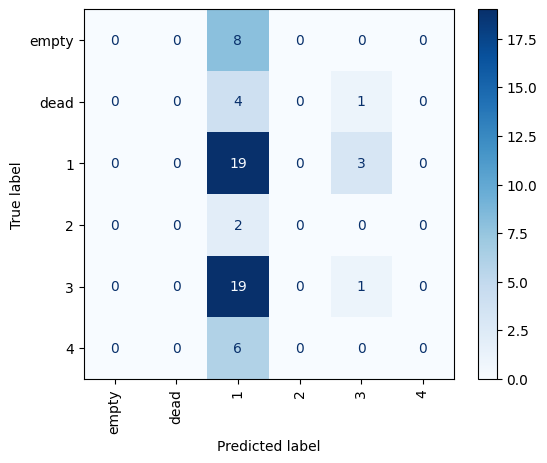

In [33]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())
display_labels = [str("empty"), str("dead"), str(1),str(2), str(3), str(4)]
display = ConfusionMatrixDisplay.from_predictions(y_true, y_pred, display_labels=display_labels, xticks_rotation=90, cmap="Blues")
display;

## 6.Classification task with 5 classes (classes: empty, #1,#2,#3 #4 )

In [34]:
# paths for data upload data known for sure
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_0 = FILE_PATH + '/empty' #empty
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/11' # class 1 but without 56.png and 57.png images
TRAIN_FEATURES_PATH_2 = FILE_PATH + '/22' # class 3
TRAIN_FEATURES_PATH_3 = FILE_PATH + '/33' # class 4
TRAIN_FEATURES_PATH_4 = FILE_PATH + '/44' # class 4
# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_0,TRAIN_FEATURES_PATH_1,TRAIN_FEATURES_PATH_2,TRAIN_FEATURES_PATH_3,TRAIN_FEATURES_PATH_4]

In [35]:
PATHES_LIST

['mariias_env/empty',
 'mariias_env/11',
 'mariias_env/22',
 'mariias_env/33',
 'mariias_env/44']

In [36]:
print("Class empty : train : ",round(len(os.listdir(PATHES_LIST[0]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[0]))*0.2))

Class empty : train :  33  test :  8


In [39]:
print("Class 1 : train : ",round(len(os.listdir(PATHES_LIST[1]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[1]))*0.2))

Class 1 : train :  88  test :  22


In [40]:
print("Class 2 : train : ",round(len(os.listdir(PATHES_LIST[2]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[2]))*0.2))

Class 2 : train :  8  test :  2


In [41]:
print("Class 3 : train : ",round(len(os.listdir(PATHES_LIST[3]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[3]))*0.2))

Class 3 : train :  82  test :  20


In [42]:
print("Class 4 : train : ",round(len(os.listdir(PATHES_LIST[4]))*0.8)," test : ",round(len(os.listdir(PATHES_LIST[4]))*0.2))

Class 4 : train :  24  test :  6


In [48]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

58

In [49]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

235

In [50]:
# checking all labels in test data
classes = []
for i in range(len(data_set_test)):
    classes.append(data_set_test[i][1])
classes

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4]

In [46]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

mean = np.mean(test_Set)
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number
    
std = torch.std(torch.stack(test_image))
print(mean,std)

0.3528692987370998 tensor(0.1682)


In [47]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

In [51]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

In [136]:
class CNN_LeNet_drop_out(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet_drop_out, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 5) # 5 classes))1,2,3,4 + empty 

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [137]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet_drop_out()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)
The model has 503,169 parameters.


In [59]:
#model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 5
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.67, Train Accuracy : 0.74, Test Loss : 0.91, Test Accuracy : 0.66
Number of Epoch : 1, Train Loss : 0.63, Train Accuracy : 0.74, Test Loss : 0.91, Test Accuracy : 0.67
Number of Epoch : 2, Train Loss : 0.62, Train Accuracy : 0.74, Test Loss : 0.95, Test Accuracy : 0.62
Number of Epoch : 3, Train Loss : 0.58, Train Accuracy : 0.77, Test Loss : 0.94, Test Accuracy : 0.64
Number of Epoch : 4, Train Loss : 0.54, Train Accuracy : 0.78, Test Loss : 0.90, Test Accuracy : 0.66


In [61]:
#save model

torch.save(model_lenet.state_dict(),'mariias_env/model/CNN_LeNet_drop_out()_5_classes(empty class).pt')

In [62]:
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/CNN_LeNet_drop_out()_5_classes(empty class).pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)

In [63]:
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)

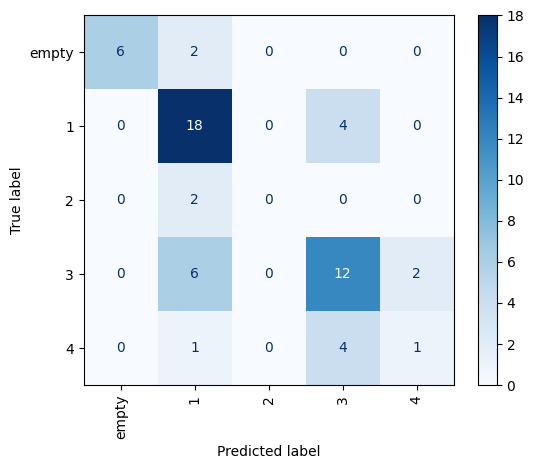

In [64]:
# confusion matrix 
# create confusion matrix 
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())
display_labels = [str("empty"), str(1),str(2), str(3), str(4)]
display = ConfusionMatrixDisplay.from_predictions(y_true, y_pred, display_labels=display_labels, xticks_rotation=90, cmap="Blues")
display;

# Experiments with 8 classes : keep0,keep1,keep2,receed0,receed1,split,empty,dead

To specify the classes for different actions of organoids, the following class labels can be used:

- "keep0" represents the class of organoids that are kept for further growth.
- "keep1" represents the class of organoids that are kept for further growth after first receeding.
- "keep2" represents the class of organoids that are kept for further growth after second receeding.
- "receed0" represents the class of organoids that show enough size of growth which requires further manipulation - first receeding
- "receed1" represents the class of organoids that show enough size of growth which requires further manipulation - second receeding
- "split" represents the class of organoids that requires splitting or division manipulation.
- "empty" represents the class of empty or void organoids.
- "dead" represents the class of organoids that are no longer viable or have died.

These class labels can be assigned to the respective organoid samples based on their observed actions or characteristics.

**RESULT**

**The test accuracy of 61%** indicates an issue with imbalanced data again. Z-stacks as a technique to increase the data set do not represent any improvements.**

**To address this problem with imbalance data, one approach is to assign more importance to the samples in the biggest class.To mitigate the impact of class imbalance, was applied class weighting techniques. By assigning higher weights to the samples belonging to the majority class. Potentially it can help the model give them more significance during training and improve overall performance.**

**Class weighting technique : Accuracy : 53%, MAX accuracy during train is 56%**

**Fine-tune on ResNet18 :  Accuracy 39% - assigned all data to biggest class**


In [71]:
# paths for data upload data known for sure
FILE_PATH = "mariias_env" 
TRAIN_FEATURES_PATH_0 = FILE_PATH + '/keep0'
TRAIN_FEATURES_PATH_1 = FILE_PATH + '/keep1' 
TRAIN_FEATURES_PATH_2 = FILE_PATH + '/keep2' 
TRAIN_FEATURES_PATH_3 = FILE_PATH + '/receed0' 
TRAIN_FEATURES_PATH_4 = FILE_PATH + '/receed1' 
TRAIN_FEATURES_PATH_5 = FILE_PATH + '/split' 
TRAIN_FEATURES_PATH_6 = FILE_PATH + '/empty0' 
TRAIN_FEATURES_PATH_7 = FILE_PATH + '/dead0' 
# list with pathe
PATHES_LIST = [TRAIN_FEATURES_PATH_0,TRAIN_FEATURES_PATH_1,TRAIN_FEATURES_PATH_2,TRAIN_FEATURES_PATH_3,TRAIN_FEATURES_PATH_4,TRAIN_FEATURES_PATH_5,TRAIN_FEATURES_PATH_6,TRAIN_FEATURES_PATH_7]

In [72]:
PATHES_LIST

['mariias_env/keep0',
 'mariias_env/keep1',
 'mariias_env/keep2',
 'mariias_env/receed0',
 'mariias_env/receed1',
 'mariias_env/split',
 'mariias_env/empty0',
 'mariias_env/dead0']

In [249]:
# print amount of images for each class

In [73]:
for i in PATHES_LIST:
    print("Class", str(i)," : train : ",round(len(os.listdir(i))*0.8)," test : ",round(len(os.listdir(i))*0.2))

Class mariias_env/keep0  : train :  748  test :  187
Class mariias_env/keep1  : train :  388  test :  97
Class mariias_env/keep2  : train :  66  test :  16
Class mariias_env/receed0  : train :  86  test :  22
Class mariias_env/receed1  : train :  40  test :  10
Class mariias_env/split  : train :  253  test :  63
Class mariias_env/empty0  : train :  116  test :  29
Class mariias_env/dead0  : train :  238  test :  60


In [250]:
# Normaliazed data set

In [74]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    #transforms.Normalize(mean, std, inplace=False)
    ])
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    #transforms.Normalize(mean, std, inplace=False)
    ])

In [75]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

484

In [76]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

1935

In [77]:
# Mean 
test_Set = []
for i in range(len(data_set_train)):
    test_Set.append(torch.mean((data_set_train[i][0])).item())# item() -as number

mean = np.mean(test_Set)
# STD
test_image = []
for i in range(len(data_set_train)):
    test_image.append((data_set_train[i][0]))# item() -as number
    
std = torch.std(torch.stack(test_image))
print(mean,std)

0.34693619374002904 tensor(0.1592)


In [78]:
# Normalize , CenterCrop
TRANSFORM_IMG = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.Normalize(mean, std, inplace=False)
    ])
# Normalize
TRANSFORM_TRAIN_IMG = transforms.Compose([

    transforms.Normalize(mean, std, inplace=False)
    ])

In [79]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8)
len(data_set_test)

484

In [80]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8)
len(data_set_train)

1935

In [81]:
# shuffle=True : 
# This process is repeated for each epoch of training, 
# which means the order in which the samples are returned to the model will be different for each epoch.
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=4,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

In [190]:
class CNN_LeNet_drop_out(nn.Module):
    """ CNN, expects input shape (1, 256, 256).
    The initial 1 corresponds to the number of channel:
    here 1 for the grayscale value.
    """
    def __init__(self):
        super(CNN_LeNet_drop_out, self).__init__()

        
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, padding=0)
        self.conv2d1 = torch.nn.Conv2d(1,6, 3, padding=1,stride=2) 
        self.conv2d2 = torch.nn.Conv2d(6, 16, 3, padding=1,stride=2)
        self.fc1 = nn.Linear(16 * 16 * 16, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 8) # 8 classes

    def forward(self, x):
        
        #torch.nn.functional.max_pool2d(input, kernel_size)
        x = F.max_pool2d(F.relu(self.conv2d1(x)), 2)
        x = F.max_pool2d(F.relu(self.conv2d2(x)), 2)
        x = F.dropout(x,p=0.5)
        x = x.reshape((x.shape[0], -1)) # x.shape[0] - save batch size or we could use `x.flatten(-3)`
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [191]:
# Print out the architecture and number of parameters.
# Instantiate the model.
model_lenet = CNN_LeNet_drop_out()
print(model_lenet)
print(f"The model has {sum([x.nelement() for x in model_lenet.parameters()]):,} parameters.")

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=8, bias=True)
)
The model has 503,424 parameters.


In [133]:
#model_lenet = CNN_LeNet_drop_out()
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model_lenet.to(device)

# Train the model
# batch size 4
epochs = 25
learning_rate = 1e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 1.54, Train Accuracy : 0.48, Test Loss : 1.53, Test Accuracy : 0.46
Number of Epoch : 1, Train Loss : 1.21, Train Accuracy : 0.57, Test Loss : 1.45, Test Accuracy : 0.48
Number of Epoch : 2, Train Loss : 1.11, Train Accuracy : 0.61, Test Loss : 1.52, Test Accuracy : 0.52
Number of Epoch : 3, Train Loss : 1.05, Train Accuracy : 0.63, Test Loss : 1.50, Test Accuracy : 0.54
Number of Epoch : 4, Train Loss : 0.98, Train Accuracy : 0.65, Test Loss : 1.63, Test Accuracy : 0.54
Number of Epoch : 5, Train Loss : 0.92, Train Accuracy : 0.68, Test Loss : 1.67, Test Accuracy : 0.53
Number of Epoch : 6, Train Loss : 0.88, Train Accuracy : 0.70, Test Loss : 1.54, Test Accuracy : 0.58
Number of Epoch : 7, Train Loss : 0.87, Train Accuracy : 0.69, Test Loss : 1.56, Test Accuracy : 0.58
Number of Epoch : 8, Train Loss : 0.84, Train Accuracy : 0.70, Test Loss : 1.62, Test Accuracy : 0.58
Number of Epoch : 9, Train Loss : 0.82, Train Accuracy : 0.70, Test Loss : 1.54, T

In [134]:
torch.save(model_lenet.state_dict(),'mariias_env/model/CNN_LeNet_drop_out()_8_classes_batch4.pt')
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/CNN_LeNet_drop_out()_8_classes_batch4.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=8, bias=True)
)

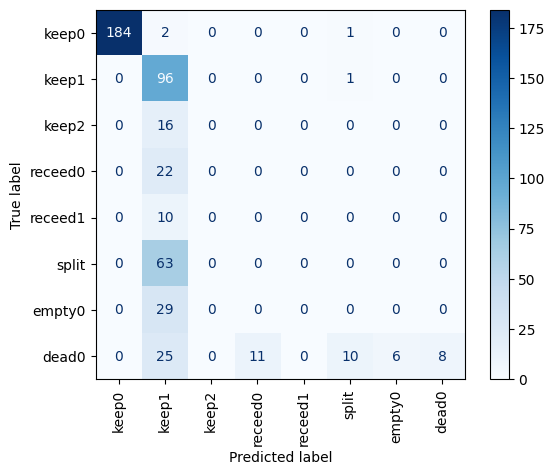

In [135]:
# confusion matrix 
# create confusion matrix 
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())
display_labels = ["keep0","keep1","keep2","receed0","receed1","split","empty0","dead0",]
display = ConfusionMatrixDisplay.from_predictions(y_true, y_pred, display_labels=display_labels, xticks_rotation=90, cmap="Blues")
display;

In [97]:
for i in PATHES_LIST:
    print("Class", str(i)," test : ",round(len(os.listdir(i))*0.2))

Class mariias_env/keep0  test :  187
Class mariias_env/keep1  test :  97
Class mariias_env/keep2  test :  16
Class mariias_env/receed0  test :  22
Class mariias_env/receed1  test :  10
Class mariias_env/split  test :  63
Class mariias_env/empty0  test :  29
Class mariias_env/dead0  test :  60


In [98]:
# batch size 12
train_loader = torch.utils.data.DataLoader(data_set_train, batch_size=12,
                                           shuffle=True)
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)
epochs = 15
learning_rate = 1e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet, F.cross_entropy, optimizer_lenet, train_loader, test_loader, epochs)

Number of Epoch : 0, Train Loss : 0.34, Train Accuracy : 0.85, Test Loss : 2.87, Test Accuracy : 0.58
Number of Epoch : 1, Train Loss : 0.36, Train Accuracy : 0.84, Test Loss : 2.90, Test Accuracy : 0.58
Number of Epoch : 2, Train Loss : 0.35, Train Accuracy : 0.84, Test Loss : 2.86, Test Accuracy : 0.59
Number of Epoch : 3, Train Loss : 0.34, Train Accuracy : 0.85, Test Loss : 2.97, Test Accuracy : 0.59
Number of Epoch : 4, Train Loss : 0.35, Train Accuracy : 0.86, Test Loss : 2.92, Test Accuracy : 0.59
Number of Epoch : 5, Train Loss : 0.34, Train Accuracy : 0.85, Test Loss : 2.83, Test Accuracy : 0.58
Number of Epoch : 6, Train Loss : 0.35, Train Accuracy : 0.86, Test Loss : 2.93, Test Accuracy : 0.58
Number of Epoch : 7, Train Loss : 0.35, Train Accuracy : 0.85, Test Loss : 2.87, Test Accuracy : 0.58
Number of Epoch : 8, Train Loss : 0.34, Train Accuracy : 0.85, Test Loss : 2.91, Test Accuracy : 0.58
Number of Epoch : 9, Train Loss : 0.35, Train Accuracy : 0.85, Test Loss : 2.87, T

### Class weighting techniques

1. Define data size

In [114]:
dataset_size = 0
for i in PATHES_LIST:
    dataset_size += len(os.listdir(i))

In [115]:
dataset_size

2419

2. Define # of classes

In [116]:
num_classes = 8

3. Define amount samples per class

In [117]:
samples_per_class = [0] * num_classes
samples_per_class

[0, 0, 0, 0, 0, 0, 0, 0]

In [119]:
for j,i in enumerate(PATHES_LIST):
    samples_per_class[j] += len(os.listdir(i))

In [120]:
samples_per_class

[935, 485, 82, 108, 50, 316, 145, 298]

4. Calculate the weight for each class

In [121]:
# Calculate the weight for each class
class_weights = [dataset_size / (num_classes * samples_per_class[i]) for i in range(num_classes)]

In [122]:
class_weights

[0.3233957219251337,
 0.6234536082474227,
 3.6875,
 2.7997685185185186,
 6.0475,
 0.9568829113924051,
 2.0853448275862068,
 1.0146812080536913]

5. Redefine CustomImageDataset_test and CustomImageDataset_train function that return *image*, *label*, *weight*

In [157]:
class CustomImageDataset_test(Dataset):
    def __init__(self, path_list, transform, ratio, class_weights):
        self.path_list = path_list
        self.len = 0
        self.img_labels = []
        self.img_sort = []
        self.transform = transform
        self.class_weights = class_weights
        
        for i, img_dir in enumerate(path_list):
            class_size = len([f for f in sorted(os.listdir(img_dir)) if f.endswith(".png")])
            class_size_test = round(class_size * (1 - ratio))  # using ratio to separate train and test dataset
            self.len += class_size_test
            self.img_labels.extend([i] * class_size_test)
            self.img_sort.extend(
                sorted([os.path.join(img_dir, f) for f in sorted(os.listdir(img_dir)) if f.endswith(".png")])[
                -self.len:])

    def __len__(self):
        return self.len

    def __getitem__(self, idx):
        img_path = self.img_sort[idx]
        image = read_image(img_path).float() / 255
        label = self.img_labels[idx]
        weight = self.class_weights[label]  # Get the weight for the corresponding class

        image = self.transform(image)
        return image, label, weight


In [158]:
# SIZE TEST DATA
data_set_test = CustomImageDataset_test(PATHES_LIST,TRANSFORM_IMG,0.8,class_weights)
len(data_set_test)

484

In [166]:
test_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=True)

In [167]:
next(iter(test_loader))

[tensor([[[[0.3579, 0.3579, 0.3825,  ..., 0.6288, 0.6041, 0.6041],
           [0.3579, 0.3579, 0.3825,  ..., 0.6288, 0.6041, 0.6041],
           [0.3579, 0.3825, 0.3825,  ..., 0.6288, 0.6288, 0.6288],
           ...,
           [0.4071, 0.4071, 0.4317,  ..., 0.7765, 0.7519, 0.7519],
           [0.4071, 0.4071, 0.4317,  ..., 0.7765, 0.7519, 0.7519],
           [0.4071, 0.4071, 0.4317,  ..., 0.7765, 0.7519, 0.7519]]]]),
 tensor([5]),
 tensor([0.9569], dtype=torch.float64)]

In [161]:
class CustomImageDataset_train(Dataset):
    def __init__(self, path_list, transform,ratio,class_weights):
        self.path_list = path_list
        self.len = 0
        self.img_labels = []
        self.img_sort = []
        self.transform = transform
        self.class_weights = class_weights
        for i, img_dir in enumerate(path_list):
            class_size = len([f for f in sorted(os.listdir(img_dir)) if f.endswith(".png")])
            class_size_train = class_size - round(class_size*(1-ratio))
            self.len += class_size_train
            self.img_labels.extend([i] * class_size_train)

            self.img_sort.extend(sorted([os.path.join(img_dir, f) for f in sorted(os.listdir(img_dir)) if f.endswith(".png")][:self.len]))
        

    def __len__(self):
        return self.len

    def __getitem__(self, idx):
        img_path = self.img_sort[idx]
        image = read_image(img_path).float() / 255.
        label = self.img_labels[idx]
        weight = self.class_weights[label]  # Get the weight for the corresponding class
        image = self.transform(image)
        image = self.augmentation(image)
        return image, label,weight
        
    def augmentation(self, image):
        
        # Random crop
        i, j, h, w = transforms.RandomCrop.get_params(image, output_size=(256, 256))
        image = TF.crop(image, i, j, h, w)
        #label = TF.crop(label, i, j, h, w)
        
        # Random horizontal flipping
        if random.random() > 0.5:
            image = TF.hflip(image)
            #label = TF.hflip(label)

        # Random vertical flipping
        if random.random() > 0.5:
            image = TF.vflip(image)
            #label = TF.vflip(label)
       
        # Rotation 45*
        degree = transforms.RandomRotation.get_params((0,45))
        image = TF.rotate(image, degree)
        #label = TF.rotate(label, degree)
        
        return image

In [163]:
# SIZE TRAIN DATA
data_set_train = CustomImageDataset_train(PATHES_LIST,TRANSFORM_TRAIN_IMG,0.8,class_weights)
len(data_set_train)

1935

In [208]:
train_loader = torch.utils.data.DataLoader(data_set_train,batch_size=4,
                                           shuffle=True)

In [211]:
next(iter(train_loader))

[tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]],
 
 
         [[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]],
 
 
         [[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]],
 
 
         [[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0.,

6. Define model 

In [206]:
# Define your model, loss function, and optimizer
model_lenet = CNN_LeNet_drop_out()
#criterion = nn.CrossEntropyLoss(weight=torch.tensor(class_weights))

7. Redefine trai_model function using class_weights in criterion

In [251]:

def train_model(model, criterion, optimizer, dataloader_train, dataloader_test, epochs,class_weights):
    for ep in range(epochs):
        # Training.
        model.train()
        losses_sum = []
        accuracy_sum = []
        for it, batch in enumerate(dataloader_train):
            # 1 Load a batch.
            x, y, weights = batch  # Modify to include weights

            # 2 Run forward pass.
            logits = model(x)
            #print(logits)
            accuracy_sum.append(accuracy(logits, y))
            #print(y)
            #print(weights)

            # 3 Compute loss (using 'criterion') with weights.
            loss = criterion(logits, y, weight=torch.tensor(class_weights)) # Modify to include weights
            #print(loss)
            losses_sum.append(loss.detach())

            # 4 Run backward pass.
            loss.backward()

            # 5 Update the weights using optimizer.
            optimizer.step()

            # 6 Zero-out the accumulated gradients.
            optimizer.zero_grad()

        accuracy_sum_test = []
        losses_sum_test = []
        for batch in dataloader_test:
            x, y, _ = batch  # Ignore weights for test set
            logits = model(x)
            accuracy_sum_test.append(accuracy(logits, y))
            loss = criterion(logits, y)
            losses_sum_test.append(loss.detach())

        print("Number of Epoch: {}, Train Loss: {:.2f}, Train Accuracy: {:.2f}, Test Loss: {:.2f}, Test Accuracy: {:.2f}".format(ep, np.mean(np.array(losses_sum)), np.mean(np.array(accuracy_sum)), np.mean(np.array(losses_sum_test)), np.mean(np.array(accuracy_sum_test))))


8. Train 

In [217]:

epochs = 25
learning_rate = 1e-4
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet,F.cross_entropy,optimizer_lenet, train_loader, test_loader, epochs,class_weights)

Number of Epoch: 0, Train Loss: 1.85, Train Accuracy: 0.38, Test Loss: 1.75, Test Accuracy: 0.42
Number of Epoch: 1, Train Loss: 1.54, Train Accuracy: 0.53, Test Loss: 1.64, Test Accuracy: 0.46
Number of Epoch: 2, Train Loss: 1.42, Train Accuracy: 0.59, Test Loss: 1.63, Test Accuracy: 0.47
Number of Epoch: 3, Train Loss: 1.35, Train Accuracy: 0.61, Test Loss: 1.72, Test Accuracy: 0.50
Number of Epoch: 4, Train Loss: 1.27, Train Accuracy: 0.63, Test Loss: 1.69, Test Accuracy: 0.50
Number of Epoch: 5, Train Loss: 1.24, Train Accuracy: 0.63, Test Loss: 1.71, Test Accuracy: 0.51
Number of Epoch: 6, Train Loss: 1.19, Train Accuracy: 0.66, Test Loss: 1.90, Test Accuracy: 0.50
Number of Epoch: 7, Train Loss: 1.16, Train Accuracy: 0.64, Test Loss: 1.77, Test Accuracy: 0.55
Number of Epoch: 8, Train Loss: 1.15, Train Accuracy: 0.66, Test Loss: 1.92, Test Accuracy: 0.48
Number of Epoch: 9, Train Loss: 1.12, Train Accuracy: 0.68, Test Loss: 1.78, Test Accuracy: 0.55
Number of Epoch: 10, Train Los

In [218]:
torch.save(model_lenet.state_dict(),'mariias_env/model/CNN_LeNet_drop_out()_8_classes_batch4_w.pt')
model = CNN_LeNet_drop_out()
model.load_state_dict(torch.load('mariias_env/model/CNN_LeNet_drop_out()_8_classes_batch4_w.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

CNN_LeNet_drop_out(
  (conv2d1): Conv2d(1, 6, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (conv2d2): Conv2d(6, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=8, bias=True)
)

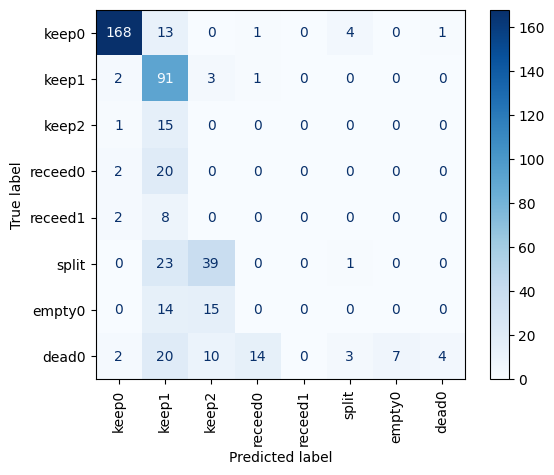

In [220]:
# confusion matrix 
# create confusion matrix 
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())
display_labels = ["keep0","keep1","keep2","receed0","receed1","split","empty0","dead0",]
display = ConfusionMatrixDisplay.from_predictions(y_true, y_pred, display_labels=display_labels, xticks_rotation=90, cmap="Blues")
display;

### Fine tune in ResNet18

In [223]:
#Libraries 
import torchvision.models as models
# Load the pre-trained ResNet18 model
resnet = models.resnet18(pretrained=True)
# Freeze all the layers in the pre-trained model
for param in resnet.parameters():
    param.requires_grad = False
# Modify the last fully-connected layer to have 8 output features instead of 1000
num_ftrs = resnet.fc.in_features
resnet.fc = nn.Linear(num_ftrs, 8)
resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)

In [229]:
model_lenet = resnet
epochs = 5
learning_rate = 1e-3
optimizer_lenet = torch.optim.AdamW(model_lenet.parameters(), lr=learning_rate)
train_model(model_lenet,F.cross_entropy,optimizer_lenet, train_loader, test_loader, epochs,class_weights)

Number of Epoch: 0, Train Loss: 1.47, Train Accuracy: 0.60, Test Loss: 1.75, Test Accuracy: 0.39
Number of Epoch: 1, Train Loss: 1.42, Train Accuracy: 0.61, Test Loss: 1.98, Test Accuracy: 0.20
Number of Epoch: 2, Train Loss: 1.41, Train Accuracy: 0.62, Test Loss: 2.12, Test Accuracy: 0.38
Number of Epoch: 3, Train Loss: 1.33, Train Accuracy: 0.61, Test Loss: 1.83, Test Accuracy: 0.39
Number of Epoch: 4, Train Loss: 1.30, Train Accuracy: 0.64, Test Loss: 1.83, Test Accuracy: 0.39


In [230]:
torch.save(model_lenet.state_dict(),'mariias_env/model/resnet_8_classes_batch4_w.pt')
model = resnet
model.load_state_dict(torch.load('mariias_env/model/resnet_8_classes_batch4_w.pt'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

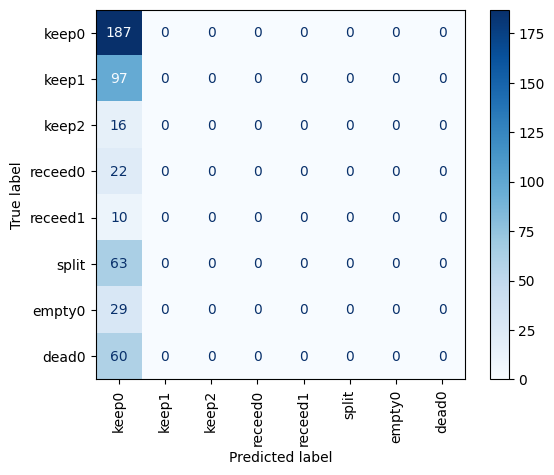

In [231]:
# confusion matrix 
# create confusion matrix 
test_best_model_loader = torch.utils.data.DataLoader(data_set_test,
                                           shuffle=False)
y_true = []
y_pred = []
 
for data in iter(test_best_model_loader):
    images,labels=data[0].to(device),data[1]  
    y_true.extend(labels.numpy())
 
    outputs=model(images)
 
    _, predicted = torch.max(outputs, 1)
    y_pred.extend(predicted.cpu().numpy())
display_labels = ["keep0","keep1","keep2","receed0","receed1","split","empty0","dead0",]
display = ConfusionMatrixDisplay.from_predictions(y_true, y_pred, display_labels=display_labels, xticks_rotation=90, cmap="Blues")
display;